## Hotspots, Forests, and Future Climates: A Geospatial Investigation of India's Changing Ecosystems

 ### Objective:
This project aims to analyze India's **biodiversity zones**, **forest cover change**, and **climate transformation** using **geospatial data** and **Python tools**. Through this study, I seek to explore how:

- **Biodiversity hotspots** are distributed across Indian states and how much of them fall within protected areas.
- **Tree cover loss** has evolved over the years across Indian states.
- **Climate zones** (as per Köppen-Geiger classification) have changed historically and how they are projected to shift within **ecological zones** and **biodiversity-rich areas**.

The goal is to present a **data-driven environmental story** using **interactive maps** and **spatial analysis** to highlight India's ecological challenges and transitions. 



##### We need to install required libraries for geospatial processing, data analysis, and interactive visualizations:
#####  -Pandas, Geopandas, matplotlib, seaborn, plotly, folium, squarify, ipyleaflet, ipywidgets




In [1]:
!pip install geopandas pandas matplotlib




In [2]:
!pip install seaborn

In [3]:
!pip install plotly


!pip show geopandas

In [5]:
! pip show geopandas

Name: geopandas
Version: 1.0.1
Summary: Geographic pandas extensions
Home-page: 
Author: 
Author-email: Kelsey Jordahl <kjordahl@alum.mit.edu>
License: BSD 3-Clause
Location: C:\Users\shach\anaconda3\Lib\site-packages
Requires: numpy, packaging, pandas, pyogrio, pyproj, shapely
Required-by: 


In [6]:
!pip install folium


In [7]:
!pip install squarify


In [8]:
!pip install ipywidgets


In [9]:
!pip install geemap


In [10]:
!pip install ipyleaflet


##### Importing necessary libraries:

In [5]:
# Core geospatial and data libraries
import geopandas as gpd
import pandas as pd


# Mapping and visualization
import folium
from folium import GeoJson
import branca

# Static plotting
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as mcolors
from matplotlib import colormaps
import squarify

In [7]:

# Static plotting
import ipywidgets as widgets
from IPython.display import display
from IPython.display import clear_output
import plotly.express as px 

# Lightweight leaflet map via ipyleaflet (optional)


from ipyleaflet import Map

### Datasets Used for Biodiversity Hotspot Analysis

To carry out the spatial analysis of **biodiversity hotspots within India**, the following **vector datasets** were used:

- **Country Boundary of India**: Used as a reference layer to visualize the national extent and clip biodiversity regions strictly within India's political boundary.
- **State Boundaries of India**: Required for state-wise aggregation of hotspot areas and to analyze regional distribution patterns.
- **Protected Areas of India**: This includes polygons for **Wildlife Sanctuaries** and **National Parks**, enabling overlap analysis with biodiversity hotspots to assess how well these regions are protected.

All datasets are in **GeoJSON or JSON** vector format and share the **same coordinate reference system**:

> **CRS**: `EPSG:4326` — Geographic Coordinate System based on **WGS 84**.

Using a consistent CRS ensures that spatial operations such as overlay, intersection, and area calculation (after reprojection) are accurately performed across all datasets.


In [9]:
# Load India's national boundary
country_boundaries=gpd.read_file("C:/Users/shach/Downloads/india-osm.geojson")
country_boundaries

# Load India's state boundaries
state_boundaries= gpd.read_file("C:/Users/shach/OneDrive/Desktop/LandSectorDataset/IND_ALL_states.json")
state_boundaries.head(5)



,country,ISO3166_2,name,enname,locname,offname,boundary,adminlevel,wikidata,wikimedia,timestamp,geometry
0,IND,IN-AN,Andaman and Nicobar Islands,Andaman and Nicobar Islands,Andaman and Nicobar Islands,Union Territory of Andaman and Nicobar Islands,administrative,4,Q40888,en:Andaman and Nicobar Islands,2019-09-29 22:07:01,"MULTIPOLYGON (((93.94419 6.99219, 93.94419 6.9..."
1,IND,IN-AP,Andhra Pradesh,Andhra Pradesh,Andhra Pradesh,,administrative,4,Q1159,en:Andhra Pradesh,2019-10-04 22:35:01,"MULTIPOLYGON (((76.76365 14.98503, 76.76736 14..."
2,IND,IN-AR,Arunachal Pradesh,Arunachal Pradesh,Arunachal Pradesh,,administrative,4,Q1162,en:Arunachal Pradesh,2019-09-28 22:16:02,"POLYGON ((91.56231 27.63221, 91.56233 27.63145..."
3,IND,IN-AS,Assam,Assam,Assam,,administrative,4,Q1164,en:Assam,2019-09-28 22:16:02,"POLYGON ((95.94798 27.93723, 95.9487 27.93796,..."
4,IND,IN-BR,Bihar,Bihar,Bihar,,administrative,4,Q1165,en:Bihar,2019-10-01 22:00:02,"POLYGON ((83.32126 25.02036, 83.32147 25.01803..."


In [11]:
#Biodiversity Hotspots Data

biodiversity_hotspots= gpd.read_file("C:/Users/shach/OneDrive/Desktop/LandSectorDataset/CI_BiodiversityHotspots.geojson")

biodiversity_hotspots.head(5)

,OBJECTID,NAME,Type,Shape_Length,Shape_Area,geometry
0,1,Chilean Winter Rainfall and Valdivian Forests,hotspot area,200.706891,40.754665,"MULTIPOLYGON (((-74.59792 -46.92502, -74.61111..."
1,2,Chilean Winter Rainfall and Valdivian Forests,outer limit,191.174978,186.085694,"POLYGON ((-70.30946 -22.96028, -70.48596 -22.7..."
2,3,Cape Floristic Region,hotspot area,93.790123,7.610383,"MULTIPOLYGON (((23.08672 -34.0731, 23.08538 -3..."
3,4,Maputaland-Pondoland-Albany,hotspot area,49.631419,25.366584,"MULTIPOLYGON (((24.48767 -34.10045, 24.488 -34..."
4,5,New Caledonia,hotspot area,24.637100,1.646954,"MULTIPOLYGON (((167.46053 -22.71228, 167.46161..."


In [21]:
biodiversity_hotspots.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [23]:
protected_areas=gpd.read_file("C:/Users/shach/OneDrive/Desktop/LandSectorDataset/featuresprotected areas.json")
protected_areas                              

,id,fid,osm_id,name,Type,State,Year,Area,feature_id,geometry
0,Protected_Area_India_Final.1,1,9339361,Cinque Islands WLS,Wildlife Sanctuary,Andaman & Nicobar Islands,1987,9.51,0,"MULTIPOLYGON (((92.68774 11.24331, 92.68774 11..."
1,Protected_Area_India_Final.2,2,22825673,Clyde Island WLS,Wildlife Sanctuary,Andaman & Nicobar Islands,1987,0.54,1,"MULTIPOLYGON (((92.5951 11.91375, 92.59511 11...."
2,Protected_Area_India_Final.3,3,22825674,James Island WLS,Wildlife Sanctuary,Andaman & Nicobar Islands,1987,2.1,2,"MULTIPOLYGON (((92.72441 11.94623, 92.72444 11..."
3,Protected_Area_India_Final.7,7,22825707,Elat Island WLS,Wildlife Sanctuary,Andaman & Nicobar Islands,1987,9.36,6,"MULTIPOLYGON (((92.66839 12.53442, 92.66842 12..."
4,Protected_Area_India_Final.4,4,9493298,Kyd Island WLS,Wildlife Sanctuary,Andaman & Nicobar Islands,1987,8,3,"MULTIPOLYGON (((92.73623 11.95269, 92.7363 11...."
...,...,...,...,...,...,...,...,...,...,...
545,Protected_Area_India_Final.546,546,233545148,Daroji Bear WLS,Wildlife Sanctuary,Karnataka,1992,82,591,"MULTIPOLYGON (((76.52953 15.24973, 76.53358 15..."
546,Protected_Area_India_Final.547,547,679236704,Madhav National Park,National Park,Madhya Pradesh,1959,375,592,"MULTIPOLYGON (((77.63197 25.58503, 77.64021 25..."
547,Protected_Area_India_Final.550,550,,Nokrek Ridge,National Park,Meghalaya,1986,47,595,"MULTIPOLYGON (((90.25558 25.51079, 90.26291 25..."
548,Protected_Area_India_Final.548,548,,Simlipal,National Park,,1979,1354,593,"MULTIPOLYGON (((86.59366 21.94428, 86.59025 21..."


In [25]:
protected_areas.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

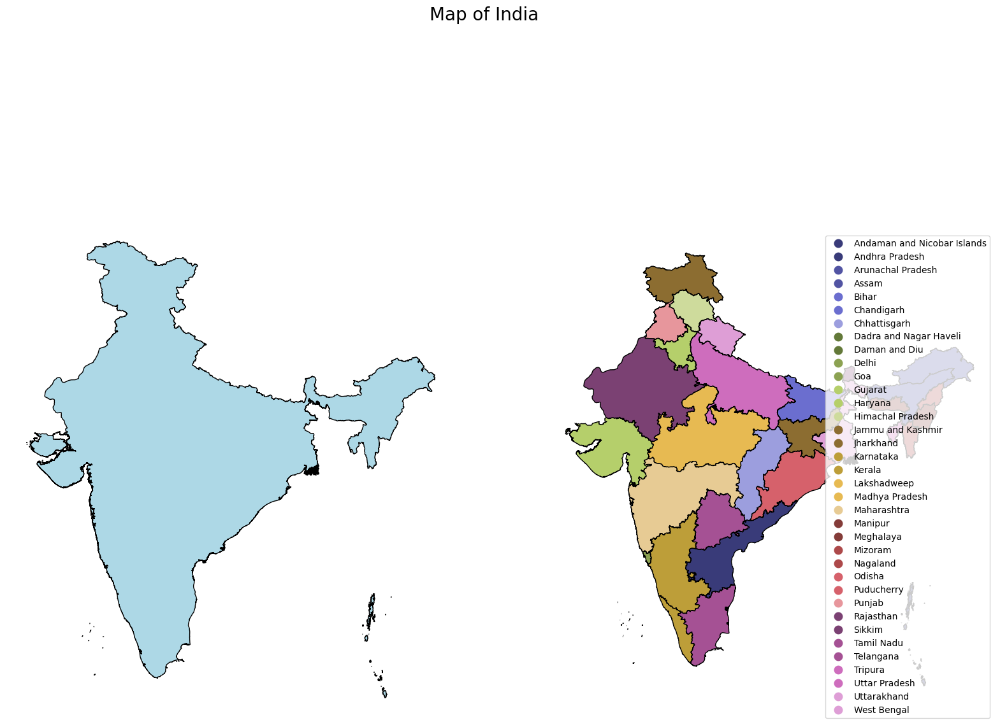

In [100]:
fig, axes = plt.subplots(1,2, figsize=(20,15))
country_boundaries.plot(ax=axes[0], color="lightblue", edgecolor='black')
state_boundaries.plot(ax=axes[1],column= 'name', cmap="tab20b", edgecolor="black", legend= True)
axes[0].axis('off')  # First subplot

axes[1].axis('off')  # Second subplot
fig.suptitle("Map of India", fontsize=20,)

plt.show()













**Disclaimer:**
The state boundary dataset used in this project is sourced from open data repositories( **OpenStreetMap**) and may not reflect the most updated or officially recognized boundaries, particularly in regions like Pakistan-occupied Kashmir (PoK).
Also this dataset contains the state boundaries before 2019. There have been changes in administrative boundaries in recent years with states being converted into union territories and merger of union territories. All of this does not affect our main purpose of the project.

In [31]:
#List name of states in India
print(state_boundaries['name'].value_counts())

name
Andaman and Nicobar Islands    1
Andhra Pradesh                 1
Arunachal Pradesh              1
Assam                          1
Bihar                          1
Chandigarh                     1
Chhattisgarh                   1
Dadra and Nagar Haveli         1
Daman and Diu                  1
Delhi                          1
Goa                            1
Gujarat                        1
Haryana                        1
Himachal Pradesh               1
Jammu and Kashmir              1
Jharkhand                      1
Karnataka                      1
Kerala                         1
Lakshadweep                    1
Madhya Pradesh                 1
Maharashtra                    1
Manipur                        1
Meghalaya                      1
Mizoram                        1
Nagaland                       1
Odisha                         1
Puducherry                     1
Punjab                         1
Rajasthan                      1
Sikkim                         1
Tamil

In [33]:
print(state_boundaries.name.count())

36


According to the current data, India has 28 states and 8 Union territories.
8 Union terrotories:
- **Andaman and Nicobar Island**
- **Chandigarh**
- **Dadra and Nagar Haveli and Daman and Diu**
- **Delhi**
- **Ladakh**
- **Lakshadweep**
- **Jammu and Kashmir**
- **Puducherry**


## Biodiversity Hotspots Analysis specific to India:

### Why This Biodiversity Analysis Matters

#### The Problem

**Biodiversity hotspots** are regions that contain a high level of species diversity, many **endemic species** (species not found anywhere else in the world) and a significant number of threatened or endangered species. To qualify as a biodiversity hotspot, an area must meet two strict criteria:

 1. Contain at least 1,500 species of vascular plants found nowhere else on Earth (known as "endemic" species).
 2. Have lost at least 70 percent of its primary native vegetation.


However, these areas are increasingly threatened by **deforestation**, **climate change**, and **human intervention**. India, being one of the 17      megadiverse countries, contains several such hotspots that are rapidly degrading.

In India, biodiversity hotspots such as the **Western Ghats**, **Indo-Burma**, **Sundaland (Nicobar Islands)**, and **the Himalayas** are not only rich in species diversity but also vital to ecosystem services, climate regulation, livelihoods, and cultural heritage.


**This project** was undertaken to:

- **Quantify the area of biodiversity hotspots** within each Indian state.
- **Evaluate the extent of legal protection** in these hotspots using protected area data.
- **Analyze tree cover loss** across Indian states over the past two decades.
- **Assess climate classification shifts** over time using Köppen-Geiger climate data, particularly in sensitive eco-regions.

#### Purpose of the Analysis:
- Provides a **spatial understanding of ecological vulnerability** across regions.
- Offers **insights for conservation planning** and policy-making.
- Highlights regions that require **urgent attention and protective measures**.
- Aligns with broader global commitments such as the **Convention on Biological Diversity (CBD)** and **Sustainable Development Goal 15 (Life on Land)**.

This multi-layered geospatial analysis brings together ecological, climatic, and land-use perspectives, offering a comprehensive view of environmental shifts in India.


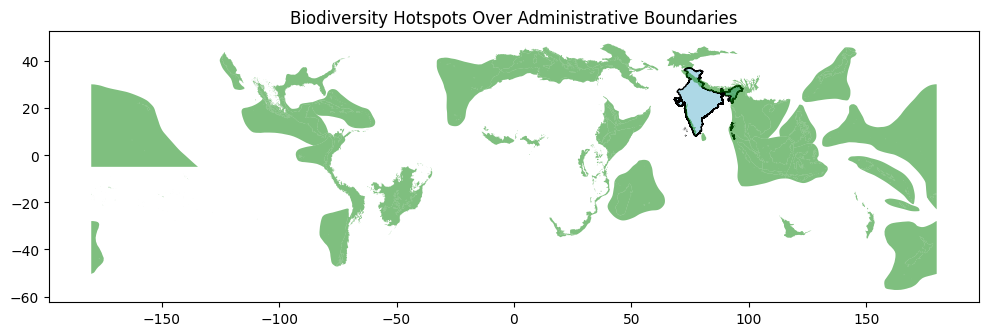

In [35]:
# overlay of biodiversity hotspots on country boundaries
ax = country_boundaries.plot(figsize=(12, 8), color='lightblue', edgecolor='black')
biodiversity_hotspots.plot(ax=ax, color='green', alpha=0.5)
plt.title("Biodiversity Hotspots Over Administrative Boundaries")
plt.show()




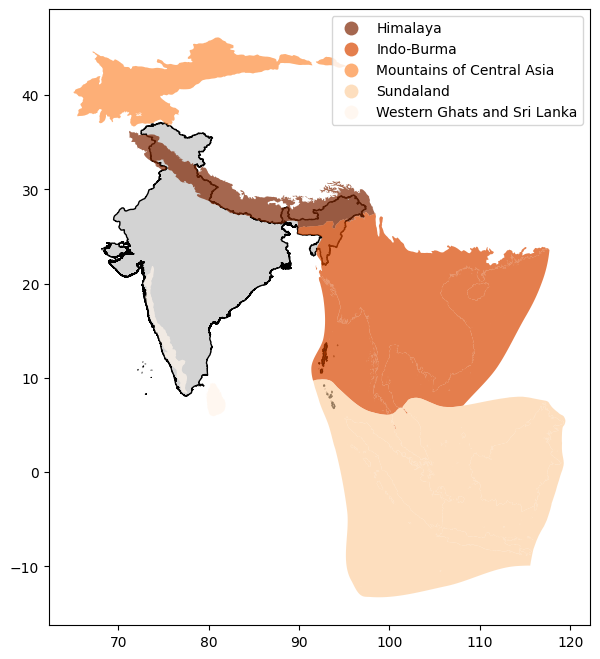

In [37]:
biodiversity_hotspots_india = gpd.sjoin(biodiversity_hotspots,country_boundaries, predicate='intersects')
ax = country_boundaries.plot(color='lightgray', edgecolor='black', figsize=(8, 8))

biodiversity_hotspots_india.plot(ax=ax,column='NAME',cmap='Oranges_r' ,alpha=0.7, legend=True)
plt.show()

### Visualizing Full Extent of Biodiversity Hotspots

To begin, I visualized the **full extent of biodiversity hotspots** using GeoPandas and Matplotlib. These hotspots are recognized at a **global scale** and hence span across **multiple countries**, including **India, Sri Lanka, Nepal, and Bhutan**.

This step helped me visually confirm that the data layers are correctly aligned and understand the **regional spread** of biodiversity zones.

However, for the purpose of this project, I aim to focus **specifically on the Indian territory**. Therefore, simply plotting the full hotspot polygons would **overestimate** biodiversity zones within India, especially when performing spatial calculations like area.

---

### Why I Moved from `sjoin` to `overlay`

I initially attempted a **spatial join (`sjoin`)** between India's boundary and the hotspot regions. But `sjoin` retains the **entire geometry** of any overlapping hotspot, even if the **majority of the region lies outside India**.

This would have led to **inaccurate area calculations**, since the hotspot's full geometry would be considered even if only a sliver overlaps India.

Therefore, I used **`gpd.overlay(..., how='intersection')`**, which accurately **clips the hotspot regions to India's boundary**, ensuring that **only the portions within India** are retained for analysis.

This decision ensures that subsequent **area calculations, spatial statistics, and mapping** reflect the **true biodiversity presence within Indian territory**.

---

From this point forward, all biodiversity-related calculations are based on these **cropped (intersected) hotspot regions**.


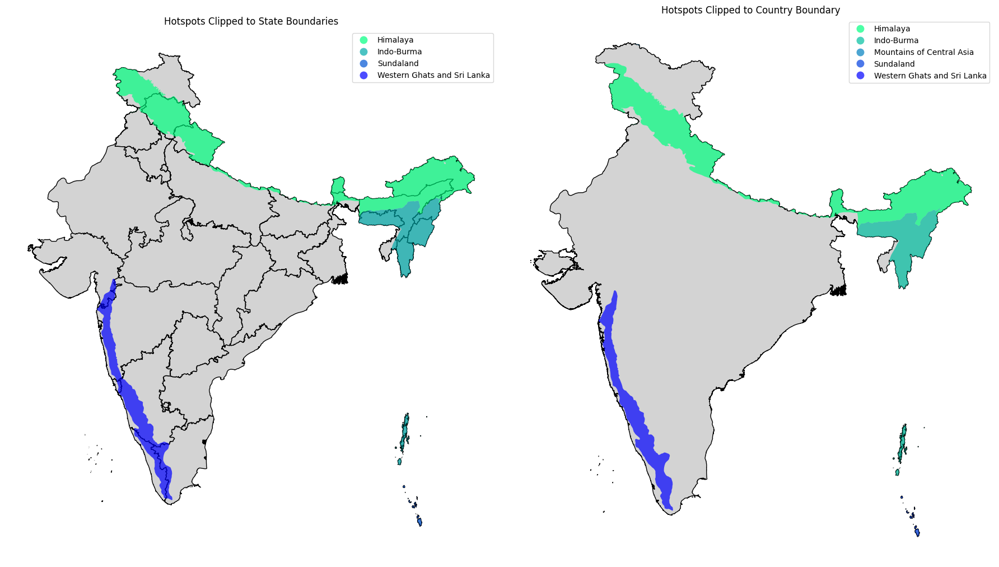

In [27]:


# Clip biodiversity hotspots
hotspots_states = gpd.overlay(biodiversity_hotspots, state_boundaries, how="intersection")
hotspots_country = gpd.overlay(biodiversity_hotspots, country_boundaries, how="intersection")

# Plot side-by-side maps
fig, axes = plt.subplots(1, 2, figsize=(18, 10))

# State boundary map
state_boundaries.plot(ax=axes[0], color='lightgray', edgecolor='black')
hotspots_states.plot(ax=axes[0], column='NAME', cmap='winter_r', alpha=0.7, legend=True)
axes[0].set_title("Hotspots Clipped to State Boundaries")
axes[0].axis('off')

# Country boundary map
country_boundaries.plot(ax=axes[1], color='lightgray', edgecolor='black')


hotspots_country.plot(ax=axes[1], column='NAME', cmap='winter_r', alpha=0.7, legend=True)
axes[1].set_title("Hotspots Clipped to Country Boundary")
axes[1].axis('off')



plt.tight_layout()
plt.show()


In [41]:
hotspots_states.head(5)

,OBJECTID,NAME,Type,Shape_Length,Shape_Area,country,ISO3166_2,name,enname,locname,offname,boundary,adminlevel,wikidata,wikimedia,timestamp,geometry
0,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-AR,Arunachal Pradesh,Arunachal Pradesh,Arunachal Pradesh,,administrative,4,Q1162,en:Arunachal Pradesh,2019-09-28 22:16:02,"POLYGON ((95.27162 26.83264, 95.33477 26.89372..."
1,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-AS,Assam,Assam,Assam,,administrative,4,Q1164,en:Assam,2019-09-28 22:16:02,"POLYGON ((89.85201 26.50256, 89.85226 26.51277..."
2,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-BR,Bihar,Bihar,Bihar,,administrative,4,Q1165,en:Bihar,2019-10-01 22:00:02,"MULTIPOLYGON (((84.45154 27.17958, 84.3793 27...."
3,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-HR,Haryana,Haryana,Haryana,,administrative,4,Q1174,en:Haryana,2019-09-28 22:16:02,"MULTIPOLYGON (((76.92169 30.82633, 76.90372 30..."
4,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-HP,Himachal Pradesh,Himachal Pradesh,Himachal Pradesh,,administrative,4,Q1177,en:Himachal Pradesh,2019-09-28 22:16:02,"POLYGON ((76.33459 31.36475, 76.30102 31.38399..."


### Preprocessing: Removing Unsupported Columns for Mapping

Before visualizing the spatial data using **Folium**, it was necessary to drop any `datetime` columns from the GeoDataFrames (e.g., state boundaries, protected areas, hotspot-state overlay results).

This is because **Folium's `GeoJson()` function serializes data to the GeoJSON format**, which is based on JSON — and **JSON does not support Python datetime objects**. 

> Attempting to pass datetime columns would raise a `TypeError: Object of type Timestamp is not JSON serializable`.

Hence, the datetime fields were dropped from the GeoDataFrames to ensure compatibility and smooth rendering of the interactive maps.


In [29]:
#Removing colums with Timestamp data type
hotspots_states_clean = hotspots_states.select_dtypes(exclude=['datetime64[ns]'])
hotspots_states_clean.head(5)








,OBJECTID,NAME,Type,Shape_Length,Shape_Area,country,ISO3166_2,name,enname,locname,offname,boundary,adminlevel,wikidata,wikimedia,geometry
0,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-AR,Arunachal Pradesh,Arunachal Pradesh,Arunachal Pradesh,,administrative,4,Q1162,en:Arunachal Pradesh,"POLYGON ((95.27162 26.83264, 95.33477 26.89372..."
1,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-AS,Assam,Assam,Assam,,administrative,4,Q1164,en:Assam,"POLYGON ((89.85201 26.50256, 89.85226 26.51277..."
2,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-BR,Bihar,Bihar,Bihar,,administrative,4,Q1165,en:Bihar,"MULTIPOLYGON (((84.45154 27.17958, 84.3793 27...."
3,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-HR,Haryana,Haryana,Haryana,,administrative,4,Q1174,en:Haryana,"MULTIPOLYGON (((76.92169 30.82633, 76.90372 30..."
4,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-HP,Himachal Pradesh,Himachal Pradesh,Himachal Pradesh,,administrative,4,Q1177,en:Himachal Pradesh,"POLYGON ((76.33459 31.36475, 76.30102 31.38399..."


In [31]:

state_boundaries_clean = state_boundaries.select_dtypes(exclude=['datetime64[ns]'])

state_boundaries_clean.head(5)







,country,ISO3166_2,name,enname,locname,offname,boundary,adminlevel,wikidata,wikimedia,geometry
0,IND,IN-AN,Andaman and Nicobar Islands,Andaman and Nicobar Islands,Andaman and Nicobar Islands,Union Territory of Andaman and Nicobar Islands,administrative,4,Q40888,en:Andaman and Nicobar Islands,"MULTIPOLYGON (((93.94419 6.99219, 93.94419 6.9..."
1,IND,IN-AP,Andhra Pradesh,Andhra Pradesh,Andhra Pradesh,,administrative,4,Q1159,en:Andhra Pradesh,"MULTIPOLYGON (((76.76365 14.98503, 76.76736 14..."
2,IND,IN-AR,Arunachal Pradesh,Arunachal Pradesh,Arunachal Pradesh,,administrative,4,Q1162,en:Arunachal Pradesh,"POLYGON ((91.56231 27.63221, 91.56233 27.63145..."
3,IND,IN-AS,Assam,Assam,Assam,,administrative,4,Q1164,en:Assam,"POLYGON ((95.94798 27.93723, 95.9487 27.93796,..."
4,IND,IN-BR,Bihar,Bihar,Bihar,,administrative,4,Q1165,en:Bihar,"POLYGON ((83.32126 25.02036, 83.32147 25.01803..."


In [96]:


# Ensuring all are in WGS84 (EPSG:4326)
state_boundaries_clean = state_boundaries_clean.to_crs(epsg=4326)
hotspots_states_clean = hotspots_states_clean.to_crs(epsg=4326)
protected_areas = protected_areas.to_crs(epsg=4326)


# Creating base map (no location/zoom yet)
m = folium.Map(tiles='cartodbpositron')


# Add state boundaries

folium.GeoJson(
    
    state_boundaries_clean,
    name="Indian States",
    style_function=lambda feature: {
        'fillColor': '#f2f2f2',
        
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.1
    },
    tooltip=folium.GeoJsonTooltip(fields=['name'])  # Adjust to your actual column name
).add_to(m)

# Add biodiversity hotspots
folium.GeoJson(
    hotspots_states_clean,
    name="Biodiversity Hotspots",
    style_function=lambda feature: {
        'fillColor': '#ff7800',
        'color': '#ff7800',
        'weight': 1,
        'fillOpacity': 0.5,
    },
    tooltip=folium.GeoJsonTooltip(fields=['NAME', 'Type'])
).add_to(m)

# Add protected areas
folium.GeoJson(
    protected_areas,
    name="Protected Areas",
    style_function=lambda feature: {
        'fillColor': 'green',
        'color': 'green',
        'weight': 1,
        'fillOpacity': 0.4
    },
    tooltip=folium.GeoJsonTooltip(fields=['name','Type'])  # Adjust if needed
).add_to(m)

# Add layer control
folium.LayerControl().add_to(m)

# Combine all for auto-fit
combined = pd.concat([
    state_boundaries_clean[['geometry']],
    hotspots_states_clean[['geometry']],
    protected_areas[['geometry']]
], ignore_index=True)


bounds = combined.total_bounds  # [minx, miny, maxx, maxy]

# Fit map to bounds
m.fit_bounds([[bounds[1], bounds[0]], [bounds[3], bounds[2]]])
# Display map
m






In [ ]:
m.save("final_map.html")

In [35]:

# Reproject to an equal-area CRS for accurate area calculations
equal_area_crs = "EPSG:6933"  # Good for world-scale area
states_proj = state_boundaries_clean.to_crs(equal_area_crs)
hotspots_proj = hotspots_states_clean.to_crs(equal_area_crs)


# Area of hotspots in each intersected region
hotspots_proj['hotspot_area'] = hotspots_proj.geometry.area

# Total area of each state
states_proj['state_area'] = states_proj.geometry.area


# Merge hotspot areas back to states

hotspot_area_sum = hotspots_proj.groupby('name')['hotspot_area'].sum().reset_index()

# Merge with state areas
merged = pd.merge(states_proj[['name', 'state_area']], hotspot_area_sum, on='name', how='left')
merged['hotspot_area'] = merged['hotspot_area'].fillna(0)

# Compute percentage area covered by hotspots
merged['hotspot_coverage_percent'] = (merged['hotspot_area'] / merged['state_area']) * 100

# View results
merged[['name', 'hotspot_coverage_percent']].sort_values(by='hotspot_coverage_percent', ascending=False)








,name,hotspot_coverage_percent
24,Nagaland,100.000000
0,Andaman and Nicobar Islands,100.000000
7,Dadra and Nagar Haveli,100.000000
21,Manipur,100.000000
23,Mizoram,100.000000
29,Sikkim,100.000000
2,Arunachal Pradesh,99.866992
22,Meghalaya,99.840183
3,Assam,98.001549
13,Himachal Pradesh,93.535031


In [94]:
combined

,geometry
0,"MULTIPOLYGON (((93.94419 6.99219, 93.94419 6.9..."
1,"MULTIPOLYGON (((76.76365 14.98503, 76.76736 14..."
2,"POLYGON ((91.56231 27.63221, 91.56233 27.63145..."
3,"POLYGON ((95.94798 27.93723, 95.9487 27.93796,..."
4,"POLYGON ((83.32126 25.02036, 83.32147 25.01803..."
...,...
612,"MULTIPOLYGON (((76.52953 15.24973, 76.53358 15..."
613,"MULTIPOLYGON (((77.63197 25.58503, 77.64021 25..."
614,"MULTIPOLYGON (((90.25558 25.51079, 90.26291 25..."
615,"MULTIPOLYGON (((86.59366 21.94428, 86.59025 21..."


###  Interpreting the 100% Hotspot Coverage

As observed in the output above, some states and union territories — such as **Manipur, Mizoram, Sikkim**, and the **Andaman & Nicobar Islands** — show **100% biodiversity hotspot coverage**. While this appears extreme at first glance, it's actually consistent with how **global biodiversity hotspot data** (like that from Conservation International and UNEP) is defined.

These regions are **entirely included** within the broader ecological zones designated as biodiversity hotspots — such as the **Indo-Burma**, **Himalaya**, and **Sundaland** regions. However, it’s important to note that **100% coverage does not literally mean every square kilometer of these states is ecologically rich** or untouched. In reality, there are **roads, buildings, agriculture, and human settlements** in these regions.

This apparent contradiction arises because:
- The hotspot boundaries are **generalized** and focus on **global ecological patterns**, not precise local administrative features.
- The designation of a region as a hotspot is based on criteria like species richness and endemism, not land use or urbanization.

So, the **100% figure represents a conceptual inclusion** — indicating that the entire state lies within the recognized hotspot region — rather than a literal, on-the-ground ecological measurement. This serves as a reminder that **spatial analysis must always be interpreted in context** of how the data was created and what it represents.


###  Other inconsistencies in result after spatial analysis

 1. **Dadra and Nagar Haveli**, a small union territory, also shows 100% hotspot coverage — which is **not ecologically accurate**. It is not included in global biodiversity hotspot region. But in the map we can see, it is included in weten ghat biodiversity hotspot. This is likely due to:

- **Generalized or smoothed boundaries** in the hotspot dataset, which may spill into neighboring regions not part of actual biodiversity zones.
- **Small area effect** — for tiny regions, even minor geometric overlap leads to large percentage values.
- Use of `overlay()` or `intersects()` that considers any geometric touch, regardless of ecological significance.

2. While spatial analysis showed a ~4% overlap of the Himalaya hotspot in Bihar, the actual mapped area is minimal and likely due to polygon  generalization or coordinate projection artifacts. Official sources do not recognize Bihar as part of a biodiversity hotspot.



**Disclaimer** : Hotspot boundaries were derived from global datasets optimized for large-scale biodiversity planning. These may not align precisely with administrative borders at the state or district level. Therefore, hotspot coverage values—especially for small or peripheral states/UTs—should be interpreted with caution.

Original Source: https://zenodo.org/record/3261807#.X-p6mtgzZPa Accessed 29/12/2020.
The data for global biodiversity hotspots has been taken from Zenodo.The GeoJSON file from Zenodo (source: Myers et al. 2000, used widely in academic and conservation work) contains generalized polygons representing global biodiversity hotspots. Also the boundaries used by Conservation International or UNEP can also be coarse or generalized. These boundaries:

1.Are often coarse and smoothed for global-scale visualization.
2.May overshoot actual recognized areas due to generalization, especially in small, adjoining regions.
3.Are not updated very frequently — and boundaries haven’t always been refined with local-level political borders in mind.

Biodiversity hotspot shapefiles (like the one from Zenodo):
1.Were originally created for global conservation planning, not state-level policy.
2.Prioritize ecoregions and species richness, not administrative accuracy.
3.Are drawn from satellite-based biogeographic boundaries, not political maps — so small states/UTs near hotspot edges can get misclassified.

## Data Limitations and Assumptions

This analysis uses spatial data on global biodiversity hotspots obtained from the Zenodo repository (Myers et al., 2000), which is widely used for large-scale ecological studies. However, there are several limitations associated with using this dataset at the state or union territory level within India:

 Generalized Hotspot Boundaries
  * The biodiversity hotspot polygons are designed for global-scale visualization and conservation planning. As such, they are:

  * Coarse in resolution,

  * Smoothed for clarity, and

 * Not precisely aligned with administrative boundaries such as states or districts.

  This can lead to misclassification, especially in smaller or bordering administrative regions.

2. Potential Overestimation
   Some states or union territories appear to have 100% of their area within a hotspot, such as Dadra and Nagar Haveli. However, this territory is not     recognized as part of any global biodiversity hotspot by official sources like Conservation International. Such cases may result from polygon           overspill or buffer zones within the dataset.

3. Stale or Infrequent Updates
   The hotspot data has not been updated recently, and ecological zones may have changed over time due to land use, climate change, or conservation        policies.

4. CRS and Area Calculations
   While care was taken to use an equal-area projection for accurate calculations, minor inaccuracies may still arise from:

   * Geometry simplification in the original dataset,

   * Precision errors in small regions, or

   * Mismatched coordinate reference systems.

##   Assumptions
   * Each state's biodiversity hotspot area was calculated using GeoPandas overlay operations, assuming equal spatial validity between state and             hotspot   geometries.
   * All results are interpreted as approximate indicators of hotspot coverage and not as definitive conservation statistics.






In [53]:


# Create the table data
data = {
    "State": [
        "Dadra and Nagar Haveli", "Bihar", "Andaman and Nicobar Islands", "Manipur", "Mizoram",
        "Nagaland", "Sikkim", "Arunachal Pradesh", "Meghalaya", "Assam"
    ],
    "% Overlap": [
        100, 4.09, 100, 100, 100,
        100, 100, 99.87, 99.84, 98.00
    ],
    "Recognized by CI?": [
        "❌", "❌", "✅", "✅", "✅",
        "✅", "✅", "✅", "✅", "✅"
    ],
    "Notes": [
        "Overlap due to generalized Western Ghats polygon",
        "Small spillover from Eastern Himalaya polygon",
        "Correct — Recognized part of Indo-Burma hotspot",
        "Correct — Part of Indo-Burma hotspot",
        "Correct — Part of Indo-Burma hotspot",
        "Correct — Part of Indo-Burma hotspot",
        "Correct — Part of Eastern Himalayan hotspot",
        "Correct — Part of Eastern Himalayan hotspot",
        "Correct — Part of Indo-Burma hotspot",
        "Correct — Part of Indo-Burma hotspot"
    ]
}

# Create DataFrame
summary_table = pd.DataFrame(data)

# Display
summary_table


,State,% Overlap,Recognized by CI?,Notes
0,Dadra and Nagar Haveli,100.00,❌,Overlap due to generalized Western Ghats polygon
1,Bihar,4.09,❌,Small spillover from Eastern Himalaya polygon
2,Andaman and Nicobar Islands,100.00,✅,Correct — Recognized part of Indo-Burma hotspot
3,Manipur,100.00,✅,Correct — Part of Indo-Burma hotspot
4,Mizoram,100.00,✅,Correct — Part of Indo-Burma hotspot
5,Nagaland,100.00,✅,Correct — Part of Indo-Burma hotspot
6,Sikkim,100.00,✅,Correct — Part of Eastern Himalayan hotspot
7,Arunachal Pradesh,99.87,✅,Correct — Part of Eastern Himalayan hotspot
8,Meghalaya,99.84,✅,Correct — Part of Indo-Burma hotspot
9,Assam,98.00,✅,Correct — Part of Indo-Burma hotspot


While most high-overlap states align with **CI-recognized hotspots**, anomalies like **Dadra and Nagar Haveli (100% overlap)** and **Bihar (4% overlap)** highlight the effect of **polygon generalization** at local scales.

In [92]:
protected_areas_proj = protected_areas.to_crs(equal_area_crs)
# Total protected area in India
protected_areas_proj["area_sqkm"] = protected_areas_proj.geometry.area / 1e6  # convert from m² to km²
total_pa_area = protected_areas_proj["area_sqkm"].sum()

# Clipping protected areas to hotspot boundaries
protected_inside_hotspots = gpd.overlay(protected_areas_proj,hotspots_proj, how="intersection", keep_geom_type=False)
protected_inside_hotspots["area_sqkm"] = protected_inside_hotspots.geometry.area / 1e6
hotspot_pa_area = protected_inside_hotspots["area_sqkm"].sum()

# % of India's protected area within hotspots
percent_pa_in_hotspots = (hotspot_pa_area / total_pa_area) * 100
print(f" Protected areas inside hotspots: {percent_pa_in_hotspots:.2f}% of India's total PA area")

# Calculating PA density for each hotspot region
# Assuming 'name' column identifies hotspot name in the `hotspots` layer
pa_density_by_hotspot = (
    protected_inside_hotspots.groupby("NAME")["area_sqkm"]
    .sum()
    .reset_index()
    .rename(columns={"area_sqkm": "protected_area_km2"})
)
hotspots_df= (hotspots_proj.groupby("NAME")["hotspot_area"]
                  .sum()
                  .reset_index()
                 )                

#  Calculating PA density as % of each hotspot's area

hotspots_df['hotspot_area_km2'] = hotspots_df['hotspot_area'] / 1e6
hotspots_area_df = hotspots_df[["NAME", "hotspot_area_km2"]]

# Merge to get density %
pa_density = pa_density_by_hotspot.merge(hotspots_area_df, on="NAME")
pa_density["pa_density_pct"] = (pa_density["protected_area_km2"] / pa_density["hotspot_area_km2"]) * 100

# Display
pa_density = pa_density.sort_values(by="pa_density_pct", ascending=False)
print(pa_density[["NAME", "protected_area_km2", "hotspot_area_km2", "pa_density_pct"]])


 Protected areas inside hotspots: 28.59% of India's total PA area
                          NAME  protected_area_km2  hotspot_area_km2  \
3  Western Ghats and Sri Lanka        17098.177919     125092.414411   
0                     Himalaya        34398.328590     298611.735572   
1                   Indo-Burma         2939.611549     114906.378336   
2                    Sundaland           18.027271       1615.793841   

   pa_density_pct  
3       13.668437  
0       11.519416  
1        2.558267  
2        1.115691  


In [45]:
hotspots_area_df


,NAME,hotspot_area_km2
0,Himalaya,298611.735572
1,Indo-Burma,114906.378336
2,Sundaland,1615.793841
3,Western Ghats and Sri Lanka,125092.414411


In [47]:
pa_density_by_hotspot

,NAME,protected_area_km2
0,Himalaya,34398.328590
1,Indo-Burma,2939.611549
2,Sundaland,18.027271
3,Western Ghats and Sri Lanka,17098.177919


### Insights: Protected Area Density Within Biodiversity Hotspots

To understand how well India's key biodiversity zones are being safeguarded, we calculated the **total area of protected zones** (wildlife sanctuaries, national parks) falling inside each biodiversity hotspot and compared it against the **total area of the hotspot**.

Despite some limitations — such as generalized hotspot boundaries that may include human-dominated land — this analysis offers a **meaningful proxy for conservation focus** in each region.

- The **Western Ghats and Sri Lanka** hotspot has the highest protected area density (13.67%), followed by the **Himalaya** (11.52%).
- **Indo-Burma** and **Sundaland** regions are notably underprotected, with <3% of their area under legal protection.

> Note: The hotspot boundaries were obtained from publicly available datasets (Zenodo.org), and may include urban areas, roads, or agricultural land. As such, the analysis reflects **spatial overlap** and not ecological condition or legal strictness of protection.

Nonetheless, the results help identify conservation gaps and can be valuable for further investigation, particularly in hotspot zones where **protection is critically low**.


In [ ]:
protected_areas_proj.crs

## Tree Cover Loss Analysis

In this section, we analyze tree cover loss across Indian states from 2001 to 2023 using data sourced from **Global Forest Watch**. The dataset captures annual tree cover loss (in hectares) for each subnational region in India, categorized by different **canopy density thresholds**.

### Dataset Overview:
- **Source**: Global Forest Watch (https://www.globalforestwatch.org/)
- **Format**: CSV (converted from Excel)
- **Spatial Scope**: Subnational (state-level) units of India
- **Time Period**: 2001 to 2023
- **Canopy Thresholds**: `0%`, `10%`, `15%`, `25%`, `30%`, `50%`, and `75%`  
  These thresholds refer to the **minimum canopy density** considered as forest cover.  
  - `0%`: Includes all tree cover loss (even sparse vegetation)
  - `10%`: Commonly used in India for defining forest cover
  - Higher thresholds represent increasingly dense forests

**Note**:- Tree Canopy refers to the layer of leaves and branches formed by the tops of trees.When we say **"tree canopy cover"**, we mean the percentage of land area covered by the vertical projection of tree crowns. In satellite imagery, it's often used to determine how dense a forested area is.

### Key Computations:
- **Total Tree Cover Loss**: Total loss (in hectares) over the period 2001–2023, per state and threshold.
- **Percentage Loss**: Expressed as a percentage of the forest extent in the year 2000 for each threshold.
- **Heatmaps**: Visual representation of loss patterns across states and thresholds.
- **Focused Analysis**: Special attention to biodiversity hotspot states, where loss has greater ecological impact.

### Notes on Data Use and Interpretation:
- The forest extent baseline is based on the year 2000. Gains in forest after 2000 are not accounted for in loss percentage.
- Subnational boundaries are generalized; minor discrepancies may exist.
- The data includes both natural forests and tree plantations.
- Interpretation of loss should consider regional ecological, legal, and policy factors.

This analysis provides crucial insights into regional forest change patterns, especially for **states within global biodiversity hotspot zones**, helping identify regions requiring conservation priority.


In [102]:
#Load tree cover loss data
tree_cover_loss= gpd.read_file("C:/Users/shach/OneDrive/Desktop/LandSectorDataset/tree cover loss india(tree cover loss India).csv")
tree_cover_loss.head(15)




,Country,subnational1,threshold,area_ha,extent_2000_ha,extent_2010_ha,gain_2000-2020_ha,tc_loss_ha_2001,tc_loss_ha_2002,tc_loss_ha_2003,...,tc_loss_ha_2014,tc_loss_ha_2015,tc_loss_ha_2016,tc_loss_ha_2017,tc_loss_ha_2018,tc_loss_ha_2019,tc_loss_ha_2020,tc_loss_ha_2021,tc_loss_ha_2022,tc_loss_ha_2023
0,,,,,,,,,,,...,,,,,,,,,,
1,India,Andaman and Nicobar,0,761084,761084,761084,2229,1415,1897,1649,...,1808,78,183,308,121,197,1423,136,102,98
2,India,Andaman and Nicobar,10,761084,690589,687885,2229,1411,1889,1634,...,1395,73,163,288,109,166,998,124,87,81
3,India,Andaman and Nicobar,15,761084,688662,684209,2229,1411,1888,1634,...,1384,73,162,288,108,166,990,123,86,80
4,India,Andaman and Nicobar,20,761084,687428,683262,2229,1411,1887,1632,...,1374,73,161,287,108,165,982,123,85,80
5,India,Andaman and Nicobar,25,761084,686301,681337,2229,1411,1887,1632,...,1369,73,161,286,107,164,977,123,85,79
6,India,Andaman and Nicobar,30,761084,684402,679440,2229,1410,1886,1631,...,1358,73,160,285,107,163,965,122,85,79
7,India,Andaman and Nicobar,50,761084,675930,665409,2229,1406,1875,1626,...,1297,72,156,281,105,156,912,120,82,76
8,India,Andaman and Nicobar,75,761084,646075,633979,2229,1378,1833,1591,...,1119,67,130,250,89,128,702,102,68,61
9,India,Andhra Pradesh,0,16004980,16004980,16004980,194340,994,874,1895,...,4068,2320,6048,6735,9999,7316,5461,3298,4346,19578


In [104]:
# Drop the first row
tree_cover_loss = tree_cover_loss.drop(index=0).reset_index(drop=True)
tree_cover_loss

,Country,subnational1,threshold,area_ha,extent_2000_ha,extent_2010_ha,gain_2000-2020_ha,tc_loss_ha_2001,tc_loss_ha_2002,tc_loss_ha_2003,...,tc_loss_ha_2014,tc_loss_ha_2015,tc_loss_ha_2016,tc_loss_ha_2017,tc_loss_ha_2018,tc_loss_ha_2019,tc_loss_ha_2020,tc_loss_ha_2021,tc_loss_ha_2022,tc_loss_ha_2023
0,India,Andaman and Nicobar,0,761084,761084,761084,2229,1415,1897,1649,...,1808,78,183,308,121,197,1423,136,102,98
1,India,Andaman and Nicobar,10,761084,690589,687885,2229,1411,1889,1634,...,1395,73,163,288,109,166,998,124,87,81
2,India,Andaman and Nicobar,15,761084,688662,684209,2229,1411,1888,1634,...,1384,73,162,288,108,166,990,123,86,80
3,India,Andaman and Nicobar,20,761084,687428,683262,2229,1411,1887,1632,...,1374,73,161,287,108,165,982,123,85,80
4,India,Andaman and Nicobar,25,761084,686301,681337,2229,1411,1887,1632,...,1369,73,161,286,107,164,977,123,85,79
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
283,India,West Bengal,20,8536526,482327,394506,132366,395,367,198,...,749,175,307,543,335,410,342,477,560,622
284,India,West Bengal,25,8536526,441567,375678,132366,390,362,196,...,705,158,263,506,306,377,313,451,537,574
285,India,West Bengal,30,8536526,407919,331883,132366,387,359,194,...,653,148,245,483,284,345,282,423,508,528
286,India,West Bengal,50,8536526,290585,196782,132366,321,282,148,...,436,111,177,377,212,241,178,294,376,333


### Aggregating Tree Cover Loss (2001–2023)

We summed up annual tree cover loss from 2001 to 2023 to get the **total loss per region and threshold**. This provides a single, cumulative metric to:

- Simplify multi-year data for analysis.
- Enable comparisons across states and thresholds.
- Support visualizations and percentage loss calculations.

Data was cleaned to ensure all yearly values are numeric before aggregation.


In [106]:
#Cleaning threshold Column

# We ensure the `threshold` column is in clean integer format for analysis:

tree_cover_loss['threshold'] = pd.to_numeric(tree_cover_loss['threshold'], errors='coerce')
tree_cover_loss = tree_cover_loss.dropna(subset=['threshold'])  # remove invalid entries

tree_cover_loss['threshold'] = tree_cover_loss['threshold'].astype(int)  # clean integer



In [66]:
tree_cover_loss["threshold"].dtype

dtype('int64')

In [108]:

#Converting Tree Cover Extent to Numeric

tree_cover_loss['extent_2000_ha'] = pd.to_numeric(tree_cover_loss['extent_2000_ha'], errors='coerce')



In [70]:
tree_cover_loss['extent_2000_ha'].dtype



dtype('int64')

In [110]:
# Aggregate Tree Cover Loss (2001-2023)
loss_cols = [f"tc_loss_ha_{year}" for year in range(2001, 2024)]
tree_cover_loss[loss_cols]=tree_cover_loss[loss_cols].apply(pd.to_numeric, errors='coerce')


# Check for any NaN values after conversion
print(tree_cover_loss[loss_cols].isna().sum())  # This will show the count of NaN in each col

tree_cover_loss["total_loss_2001_2023"] = tree_cover_loss[loss_cols].sum(axis=1)
print(tree_cover_loss[["Country", "subnational1", "threshold", "total_loss_2001_2023"]].head(10))





tc_loss_ha_2001    0
tc_loss_ha_2002    0
tc_loss_ha_2003    0
tc_loss_ha_2004    0
tc_loss_ha_2005    0
tc_loss_ha_2006    0
tc_loss_ha_2007    0
tc_loss_ha_2008    0
tc_loss_ha_2009    0
tc_loss_ha_2010    0
tc_loss_ha_2011    0
tc_loss_ha_2012    0
tc_loss_ha_2013    0
tc_loss_ha_2014    0
tc_loss_ha_2015    0
tc_loss_ha_2016    0
tc_loss_ha_2017    0
tc_loss_ha_2018    0
tc_loss_ha_2019    0
tc_loss_ha_2020    0
tc_loss_ha_2021    0
tc_loss_ha_2022    0
tc_loss_ha_2023    0
dtype: int64
  Country         subnational1  threshold  total_loss_2001_2023
0   India  Andaman and Nicobar          0                 19604
1   India  Andaman and Nicobar         10                 18423
2   India  Andaman and Nicobar         15                 18390
3   India  Andaman and Nicobar         20                 18356
4   India  Andaman and Nicobar         25                 18339
5   India  Andaman and Nicobar         30                 18303
6   India  Andaman and Nicobar         50               

In [112]:
tree_cover_loss['percentage_loss'] = (tree_cover_loss['total_loss_2001_2023'] / tree_cover_loss['extent_2000_ha']) * 100
tree_cover_loss.head(5)
                



,Country,subnational1,threshold,area_ha,extent_2000_ha,extent_2010_ha,gain_2000-2020_ha,tc_loss_ha_2001,tc_loss_ha_2002,tc_loss_ha_2003,...,tc_loss_ha_2016,tc_loss_ha_2017,tc_loss_ha_2018,tc_loss_ha_2019,tc_loss_ha_2020,tc_loss_ha_2021,tc_loss_ha_2022,tc_loss_ha_2023,total_loss_2001_2023,percentage_loss
0,India,Andaman and Nicobar,0,761084,761084,761084,2229,1415,1897,1649,...,183,308,121,197,1423,136,102,98,19604,2.575800
1,India,Andaman and Nicobar,10,761084,690589,687885,2229,1411,1889,1634,...,163,288,109,166,998,124,87,81,18423,2.667723
2,India,Andaman and Nicobar,15,761084,688662,684209,2229,1411,1888,1634,...,162,288,108,166,990,123,86,80,18390,2.670396
3,India,Andaman and Nicobar,20,761084,687428,683262,2229,1411,1887,1632,...,161,287,108,165,982,123,85,80,18356,2.670243
4,India,Andaman and Nicobar,25,761084,686301,681337,2229,1411,1887,1632,...,161,286,107,164,977,123,85,79,18339,2.672151


In [114]:
tree_cover_loss['percentage_loss'].dtype

dtype('float64')

In [116]:
tree_cover_loss[loss_cols]



,tc_loss_ha_2001,tc_loss_ha_2002,tc_loss_ha_2003,tc_loss_ha_2004,tc_loss_ha_2005,tc_loss_ha_2006,tc_loss_ha_2007,tc_loss_ha_2008,tc_loss_ha_2009,tc_loss_ha_2010,...,tc_loss_ha_2014,tc_loss_ha_2015,tc_loss_ha_2016,tc_loss_ha_2017,tc_loss_ha_2018,tc_loss_ha_2019,tc_loss_ha_2020,tc_loss_ha_2021,tc_loss_ha_2022,tc_loss_ha_2023
0,1415,1897,1649,213,3566,832,801,1741,844,780,...,1808,78,183,308,121,197,1423,136,102,98
1,1411,1889,1634,212,3545,818,797,1740,840,776,...,1395,73,163,288,109,166,998,124,87,81
2,1411,1888,1634,212,3543,818,796,1739,840,775,...,1384,73,162,288,108,166,990,123,86,80
3,1411,1887,1632,212,3541,818,795,1738,839,775,...,1374,73,161,287,108,165,982,123,85,80
4,1411,1887,1632,212,3540,818,794,1738,839,775,...,1369,73,161,286,107,164,977,123,85,79
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
283,395,367,198,586,457,795,1527,1555,914,2050,...,749,175,307,543,335,410,342,477,560,622
284,390,362,196,576,451,785,1516,1543,908,2035,...,705,158,263,506,306,377,313,451,537,574
285,387,359,194,570,447,777,1503,1534,897,2021,...,653,148,245,483,284,345,282,423,508,528
286,321,282,148,357,352,576,1265,1267,729,1669,...,436,111,177,377,212,241,178,294,376,333


In [118]:
tree_cover_loss["subnational1"].nunique()


36

### Tree Cover Loss Heatmap by Canopy Cover Threshold

This interactive heatmap visualizes the **percentage of tree cover loss** across Indian states at different canopy cover thresholds. The thresholds represent minimum canopy density percentages, which correspond to forest definitions used in India for monitoring and reporting.

- The **percentage loss** metric normalizes tree cover loss relative to the initial forest extent, allowing meaningful comparison between states regardless of their forest size.
- Users can select from descriptive canopy cover thresholds using the dropdown menu to explore loss patterns under various forest density definitions.
- This helps identify states experiencing significant forest degradation, informing conservation priorities aligned with forest density standards.

The heatmap uses a color gradient from light to dark, indicating lower to higher percentage loss.


### What do 0%, 10%, 30%, 75% thresholds mean?

These are canopy cover density thresholds — that is, the minimum percentage of tree crown cover in a pixel (usually 30m x 30m) that qualifies as "forest" in the analysis.

| Threshold | What it includes                              | Real-life implication                      |
|-----------|----------------------------------------------|--------------------------------------------|
| 0%        | Every patch of land with any tree presence — even one sparse tree. | Scrublands, plantations, degraded forests included. |
| 10%       | Areas where ≥10% of the ground is covered by tree crowns. | Low-density forest areas; used in FAO's forest definition. |
| 30%       | Only those pixels where ≥30% is tree crown.  | Moderate to dense forests.                  |
| 75%       | Only dense forests — tree crowns cover at least 75% of the ground. | Intact rainforests, rich biodiversity zones. |


In [120]:


# mapping of threshold values to descriptive labels
threshold_labels = {
    0: "0% canopy cover (all tree cover loss)",
    10: "10% canopy cover (min forest)",
    15: "15% canopy cover",
    25: "25% canopy cover",
    30: "30% canopy cover",
    50: "50% canopy cover (moderate forest)",
    75: "75% canopy cover (dense forest)"
}

# Inverse mapping for dropdown options
dropdown_options = [(label, val) for val, label in threshold_labels.items() if val in tree_cover_loss['threshold'].unique()]

def update_heatmap(threshold):
    filtered = tree_cover_loss[tree_cover_loss['threshold'] == threshold]
    if filtered.empty:
        print("No data available for this threshold.")
        return
    
    heatmap_data = filtered.pivot_table(
        index='subnational1',
        values='percentage_loss',
        aggfunc='sum'
    )
    
    plt.figure(figsize=(10, len(heatmap_data) * 0.4))
    sns.heatmap(
        heatmap_data,
        annot=True,
        cmap='YlGnBu',
        fmt='.1f',
        linewidths=0.5,
        cbar_kws={'label': '% Tree Cover Loss'}
    )
    plt.title(f"% Tree Cover Loss by State at Threshold: {threshold_labels[threshold]}")
    plt.xlabel("Percentage Loss")
    plt.ylabel("State/Region")
    plt.tight_layout()
    plt.show()

threshold_dropdown = widgets.Dropdown(
    options=dropdown_options,
    value=10,
    description='Threshold:'
)

interactive_plot = widgets.interactive(update_heatmap, threshold=threshold_dropdown)
display(interactive_plot)


interactive(children=(Dropdown(description='Threshold:', index=1, options=(('0% canopy cover (all tree cover l…

In [122]:
# pivot table for tree cover loss percentage by state and threshold
heatmap_data = tree_cover_loss.pivot_table(
    values='percentage_loss',       # Data values: percentage tree cover loss
    index='subnational1',           # Rows: Indian states/subnational regions
    columns='threshold',            # Columns: canopy cover thresholds
    aggfunc='sum',                  # Aggregate function to sum percentage loss if duplicates exist
    fill_value=0                   # Filling missing values with 0 for clean plotting
)

# pivot table display
print(heatmap_data.head())


threshold                  0          10         15         20         25  \
subnational1                                                                
Andaman and Nicobar  2.575800   2.667723   2.670396   2.670243   2.672151   
Andhra Pradesh       0.621938   2.827028   3.054102   3.142313   3.285474   
Arunachal Pradesh    3.684693   4.179992   4.179135   4.168669   4.158450   
Assam                4.646557  10.613223  11.039364  11.172771  11.435341   
Bihar                0.028971   0.400362   0.573312   0.607774   0.676421   

threshold                   30         50         75  
subnational1                                          
Andaman and Nicobar   2.674305   2.671726   2.628797  
Andhra Pradesh        3.571532   4.193760   5.593933  
Arunachal Pradesh     4.161265   4.192073   4.127567  
Assam                11.780299  13.040902  14.027998  
Bihar                 0.829422   0.961538   0.891756  


### Insights From the Heatmap

- States like Tripura, NCT of Delhi, Nagaland, Mizoram, and Manipur show relatively high percentage of tree cover loss at the 50% canopy cover threshold, indicating significant loss in denser forest areas.

- Lower thresholds (e.g., 10%) reveal overall deforestation including areas with sparse tree cover.

- This visualization highlights regional differences in forest health, which can guide targeted forest conservation and management efforts.


### Comparison of Tree Cover Loss at 15% vs 75% Threshold

In this section, we compare total tree cover loss between two distinct canopy cover thresholds:

- **15% Threshold**: Represents areas with relatively *sparser tree cover*, including open woodlands and fragmented forests.
- **75% Threshold**: Represents *dense forests* with high canopy closure, typically considered ecologically richer and more carbon-dense.

#### Why Compare These Two?

- This contrast helps understand how deforestation impacts vary across forest density levels.
- States may show **substantial loss at 15%** but relatively **low at 75%**, indicating clearing of sparse forests or edge areas.
- On the other hand, **high loss at 75%** suggests serious degradation of *core dense forest areas*, which are often more biodiverse and ecologically sensitive.

This comparison provides insight into the **quality of forest loss**, not just the quantity, and is essential for designing **targeted conservation and afforestation strategies**.


In [124]:
tree_cover_loss['threshold'] = pd.to_numeric(tree_cover_loss['threshold'], errors='coerce')

tree_cover_loss_15 = tree_cover_loss[tree_cover_loss["threshold"] == 15]


tree_cover_loss_15.head(10)

,Country,subnational1,threshold,area_ha,extent_2000_ha,extent_2010_ha,gain_2000-2020_ha,tc_loss_ha_2001,tc_loss_ha_2002,tc_loss_ha_2003,...,tc_loss_ha_2016,tc_loss_ha_2017,tc_loss_ha_2018,tc_loss_ha_2019,tc_loss_ha_2020,tc_loss_ha_2021,tc_loss_ha_2022,tc_loss_ha_2023,total_loss_2001_2023,percentage_loss
2,India,Andaman and Nicobar,15,761084,688662,684209,2229,1411,1888,1634,...,162,288,108,166,990,123,86,80,18390,2.670396
10,India,Andhra Pradesh,15,16004980,1498509,1258302,194340,877,725,1604,...,2905,3247,2964,2397,1730,1046,1508,3914,45766,3.054102
18,India,Arunachal Pradesh,15,8199543,6371294,6228242,64907,8641,7034,6432,...,19353,19363,11590,9855,12967,14579,14789,11889,266265,4.179135
26,India,Assam,15,7849232,3004213,2805440,163055,6729,8127,5518,...,26087,18548,15350,11718,19002,19603,19322,18443,331646,11.039364
34,India,Bihar,15,9423241,257626,316710,42365,153,46,33,...,10,38,10,5,23,12,12,52,1477,0.573312
42,India,Chandigarh,15,11812,848,1105,197,0,0,0,...,0,0,0,0,0,0,0,0,13,1.533019
50,India,Chhattisgarh,15,13543155,3431974,2844759,57778,2792,2179,1393,...,2723,2011,2832,2534,1348,1833,2500,3772,58454,1.703218
58,India,Dadra and Nagar Haveli,15,49152,3567,898,425,0,0,0,...,0,0,0,0,0,0,0,0,0,0.000000
66,India,Daman and Diu,15,8354,259,39,168,0,0,0,...,0,0,0,0,0,0,0,0,0,0.000000
74,India,Goa,15,369568,178016,142351,4030,7,6,12,...,97,80,68,52,70,35,33,109,1092,0.613428


In [126]:
# Total loss at 75 threshold
tree_cover_loss_75 = tree_cover_loss[tree_cover_loss['threshold'] == 75]

tree_cover_loss_75


,Country,subnational1,threshold,area_ha,extent_2000_ha,extent_2010_ha,gain_2000-2020_ha,tc_loss_ha_2001,tc_loss_ha_2002,tc_loss_ha_2003,...,tc_loss_ha_2016,tc_loss_ha_2017,tc_loss_ha_2018,tc_loss_ha_2019,tc_loss_ha_2020,tc_loss_ha_2021,tc_loss_ha_2022,tc_loss_ha_2023,total_loss_2001_2023,percentage_loss
7,India,Andaman and Nicobar,75,761084,646075,633979,2229,1378,1833,1591,...,130,250,89,128,702,102,68,61,16984,2.628797
15,India,Andhra Pradesh,75,16004980,254490,142020,194340,486,344,669,...,571,896,521,535,402,237,339,746,14236,5.593933
23,India,Arunachal Pradesh,75,8199543,5214282,4665671,64907,7643,6308,5785,...,14731,14482,8454,7059,9635,10904,11312,9168,215223,4.127567
31,India,Assam,75,7849232,1335358,1104261,163055,4779,5566,3813,...,13358,9428,7124,5646,8756,9474,9143,8924,187324,14.027998
39,India,Bihar,75,9423241,31623,32205,42365,40,8,9,...,0,13,1,0,2,2,0,4,282,0.891756
47,India,Chandigarh,75,11812,108,115,197,0,0,0,...,0,0,0,0,0,0,0,0,7,6.481481
55,India,Chhattisgarh,75,13543155,89636,26537,57778,897,337,139,...,175,133,157,153,54,97,141,169,5531,6.170512
63,India,Dadra and Nagar Haveli,75,49152,0,0,425,0,0,0,...,0,0,0,0,0,0,0,0,0,NaN
71,India,Daman and Diu,75,8354,0,0,168,0,0,0,...,0,0,0,0,0,0,0,0,0,NaN
79,India,Goa,75,369568,26048,17751,4030,4,1,2,...,9,10,10,7,3,2,1,4,181,0.694871


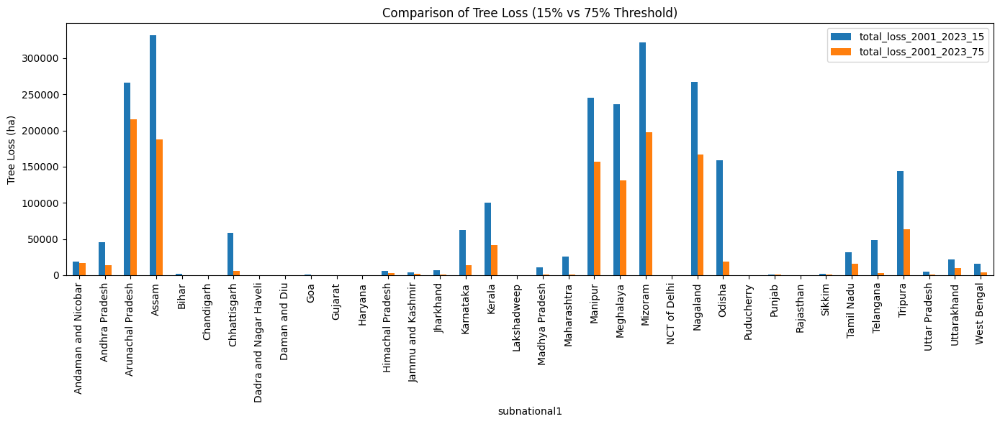

In [128]:


# Merge to compare
compare_df = pd.merge(tree_cover_loss_15[['subnational1', 'total_loss_2001_2023']], 
                      tree_cover_loss_75[['subnational1', 'total_loss_2001_2023']], 
                      on='subnational1', suffixes=('_15', '_75'))

compare_df.plot(kind='bar', figsize=(14,6), x='subnational1')
plt.title('Comparison of Tree Loss (15% vs 75% Threshold)')

plt.ylabel('Tree Loss (ha)')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()


### Insight: Tree Cover Loss Comparison (15% vs 75% Canopy Threshold)

Across all states, total tree loss at the **15% threshold** is naturally higher than at the **75% threshold**, as it includes all forested areas (sparse + dense). However, the relative comparison still yields valuable insights:

- **Assam** has the **highest total loss at 15%**, followed by **Mizoram, Nagaland, Arunachal Pradesh, Manipur**, and others. This suggests widespread deforestation, including in fragmented or edge forests.
- At **75% threshold**, **Arunachal Pradesh** shows the **highest loss**, followed by **Mizoram, Assam, and Manipur**, indicating substantial degradation of **dense, ecologically sensitive forests**.

These trends mirror known biodiversity hotspots in India, especially in the **Eastern Himalayas and Northeastern states**, where high biodiversity coincides with high deforestation pressure.

Such insights can help in:
- Targeting conservation in dense forest cores.
- Planning afforestation in fragmented forest edges.
- Informing state-level forest management priorities.


---



| State                 | Loss at 15% (ha) | Loss at 75% (ha) | % of 15% Loss That Is Dense Forest |
|----------------------|------------------|------------------|-------------------------------------|
| **Assam**            | 331,646          | 187,324          | ~56.5%                              |
| **Arunachal Pradesh**| 266,265          | 215,223          | ~80.9%                              |


### What This Tells Us

#### 1. **Assam: Extensive Tree Cover Loss, Particularly in Open Canopy Forests**
- Assam recorded the **highest total tree cover loss** at the 15% threshold (≈331,646 ha), signaling extensive forest degradation over the past two decades.
- Only about **56.5%** of this loss is from **dense forests (≥75% canopy)**, indicating that much of the deforestation is occurring in **open canopy or fragmented forests**.
- Such widespread degradation — even outside dense forests — is ecologically damaging, leading to habitat fragmentation, disruption of wildlife corridors, and long-term loss of ecosystem services.
- The drivers likely include **agricultural expansion**, **tea plantations**, **urban sprawl**, and **infrastructure development**, which are known pressures in Assam.

#### 2. **Arunachal Pradesh: Intense Loss Concentrated in Dense, Primary Forests**
- Arunachal Pradesh, while showing a somewhat lower total loss at the 15% threshold (≈266,265 ha), had about **80.9%** of this loss occurring in **dense forest zones (≥75% canopy)**.
- This suggests **significant intrusion into core, high-quality forests**, which are often **irreplaceable** in terms of biodiversity and carbon sequestration.
- As a part of the **Eastern Himalaya biodiversity hotspot**, such loss represents an **acute conservation concern**, threatening endemic species and ecosystem resilience.
- The trend may be influenced by **logging**, **shifting cultivation**, and **linear infrastructure** development (roads, hydro projects) that penetrate interior forest areas.

---

### Strategic Insights for Forest Management

| State              | Conservation Implications                                                                 |
|-------------------|--------------------------------------------------------------------------------------------|
| **Assam**          | Requires urgent measures for **landscape restoration**, including reforestation and better **management of mosaic forests**. Forest governance must address pressure in non-dense but ecologically valuable areas. |
| **Arunachal Pradesh** | Calls for **protection of dense, old-growth forests** and stricter enforcement against encroachment. Participatory forest monitoring and indigenous land stewardship can be key strategies. |

> Even though the **types of forest loss differ**, both cases highlight the need for **region-specific conservation strategies** to meet India's biodiversity and climate goals.


### Choropleth Map: Tree Cover Loss in Biodiversity States (Threshold: 10%)

This map visualizes the percentage of tree cover loss (2001–2023) at the 10% canopy threshold — the minimum definition of forest cover used by the Forest Survey of India (FSI). This broader view helps capture loss across all forest types, including open forests, making it more relevant for biodiversity monitoring and conservation planning.


In [132]:
# Total loss at 10 threshold
tree_cover_loss_10 = tree_cover_loss[tree_cover_loss['threshold'] == 10]


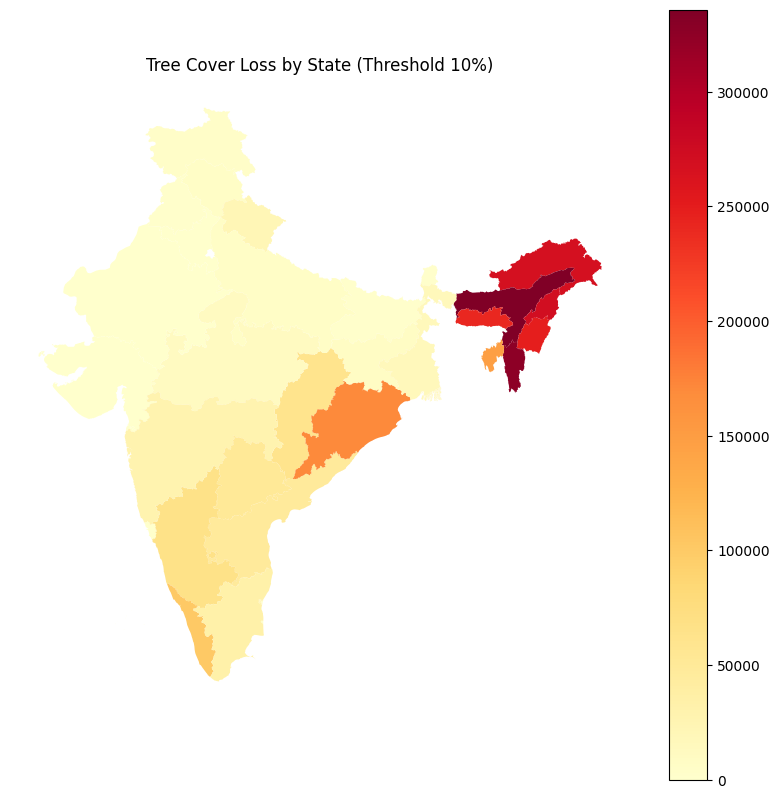

In [134]:

# Merge with EDA results
choropleth_data = state_boundaries.merge(tree_cover_loss_10[['subnational1', 'total_loss_2001_2023']], 
                                   left_on='name', right_on='subnational1')

choropleth_data.plot(column='total_loss_2001_2023', cmap='YlOrRd', legend=True, figsize=(10,10))
plt.title("Tree Cover Loss by State (Threshold 10%)")
plt.axis('off')
plt.show()


In [96]:
tree_cover_loss[['subnational1','total_loss_2001_2023','percentage_loss']].sort_values(by='percentage_loss',ascending=False).head(15)

,subnational1,total_loss_2001_2023,percentage_loss
119,Jharkhand,996,48.514369
263,Tripura,63508,30.217012
262,Tripura,130004,22.335500
192,Nagaland,355336,21.406273
261,Tripura,137413,20.531068
260,Tripura,142957,20.382101
259,Tripura,143262,20.054510
190,NCT of Delhi,7,20.000000
193,Nagaland,271477,19.996582
194,Nagaland,267120,19.965618


### Tree Cover Loss Trends in High-Loss States

The earlier choropleth map showed that certain states had notably higher percentages of tree cover loss, as indicated by their darker shades. To explore these patterns further, we plot the annual tree loss trends for these states. This helps in identifying whether the loss was concentrated in specific years or part of a long-term trend, providing valuable temporal insight into regional deforestation dynamics.By including a low-loss state like **Sikkim** for contrast, we can better understand the **temporal dynamics** and **intensity of deforestation** across regions with similar terrain.





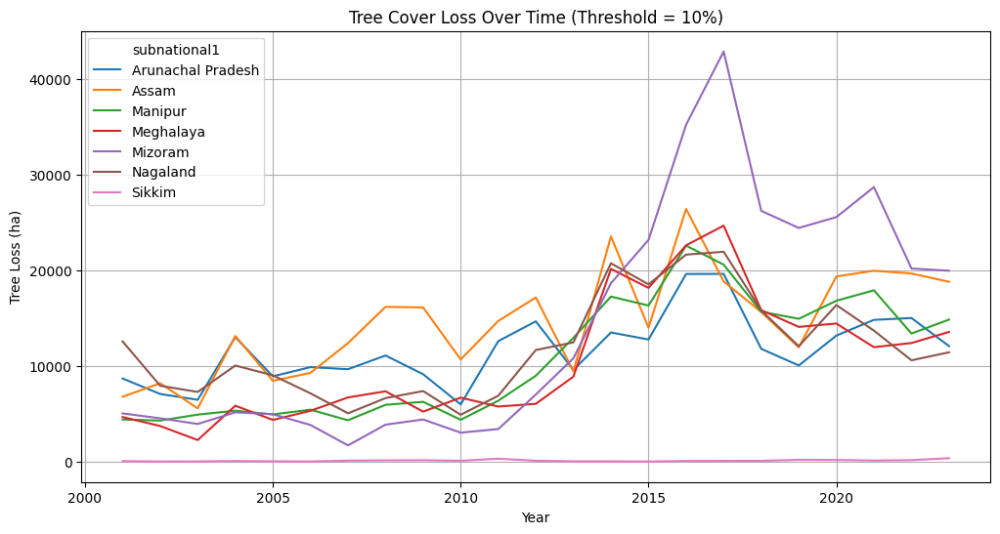

In [136]:
states_to_plot = ['Arunachal Pradesh', 'Assam', 'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland','Sikkim']
df_time = tree_cover_loss_10[tree_cover_loss_10['subnational1'].isin(states_to_plot)]

# Convert to long format
df_long = df_time.melt(id_vars='subnational1', value_vars=loss_cols,
                       var_name='year', value_name='loss')
df_long['year'] = df_long['year'].str.extract(r'(\d+)').astype(int)

plt.figure(figsize=(12,6))
sns.lineplot(data=df_long, x='year', y='loss', hue='subnational1')
plt.title('Tree Cover Loss Over Time (Threshold = 10%)')
plt.ylabel('Tree Loss (ha)')
plt.xlabel('Year')
plt.grid(True)
plt.show()

In [100]:
df_time


,Country,subnational1,threshold,area_ha,extent_2000_ha,extent_2010_ha,gain_2000-2020_ha,tc_loss_ha_2001,tc_loss_ha_2002,tc_loss_ha_2003,...,tc_loss_ha_2016,tc_loss_ha_2017,tc_loss_ha_2018,tc_loss_ha_2019,tc_loss_ha_2020,tc_loss_ha_2021,tc_loss_ha_2022,tc_loss_ha_2023,total_loss_2001_2023,percentage_loss
17,India,Arunachal Pradesh,10,8199543,6432835,6302553,64907,8678,7059,6453,...,19596,19612,11780,10040,13162,14805,14996,12061,268892,4.179992
25,India,Assam,10,7849232,3164948,3010461,163055,6772,8181,5558,...,26396,18828,15621,11931,19340,19939,19647,18786,335903,10.613223
161,India,Manipur,10,2232073,1764568,1773766,15758,4396,4282,4906,...,22562,20576,15660,14916,16802,17894,13379,14832,248503,14.082937
169,India,Meghalaya,10,2251620,1795672,1731907,23721,4653,3712,2246,...,22594,24649,15825,14070,14425,11951,12385,13546,240411,13.388358
177,India,Mizoram,10,2125175,1983904,1869164,16562,5029,4520,3927,...,35188,42849,26198,24409,25541,28676,20174,19938,326314,16.448074
193,India,Nagaland,10,1659962,1357617,1375525,30302,12555,7922,7273,...,21625,21922,15784,12055,16350,13681,10579,11417,271477,19.996582
233,India,Sikkim,10,708307,272100,279957,6551,43,10,16,...,61,74,76,182,166,108,149,349,2227,0.818449


### Tree Cover Loss Trends in Northeastern States: Line Plot Insights

The line plot visualizes the temporal trend (2001–2023) of tree cover loss at the 10% canopy threshold across seven northeastern states: **Mizoram, Manipur, Nagaland, Arunachal Pradesh, Assam, Meghalaya, and Sikkim**.

#### Key Observations:

-By 2023, **cumulative forest loss** in Mizoram accounted for **~16.45%** of its initial tree-covered area. **Mizoram** shows a steep increase in tree cover loss beginning around **2011**, peaking sharply in **2017**, followed by a gradual decline.
- Key drivers include:
  - This trend may reflect the timeline of the **State Action Plan on Climate Change (SAPCC)** implemented between **2012–2017**, suggesting partial policy impact.
  
- **All states in the plot exhibit their highest loss between 2016–2018**, pointing to a **regional surge** in deforestation — possibly due to policy gaps, extreme weather, or increased human activities.

- **Sikkim**, in stark contrast, maintains **consistently low levels of tree loss** throughout the period.
  - This can be attributed to:
    - **Stringent forest regulations**: e.g., illegal tree felling is a non-bailable offense.
    - **Citizen-driven programs** like:
   
                                                                                                                                                                                                      
      - *"Ten Minutes to Earth"*: mass tree planting every year since 2009.
      - *"Mero Rukh, Mero Santati"*: 108 trees planted per newborn child.
    - **Protected Area Coverage**: A large share of Sikkim’s land is under national parks, wildlife sanctuaries, and biosphere reserves.

#### Broader Interpretation:

Despite having conservation programs, many states still show high tree loss due to:
- **Shifting cultivation (jhum farming)**
- **Urbanization and infrastructure expansion**
- **Illegal logging**
- **Weak enforcement of regulations**

Moreover, **natural drivers** — such as forest fires, floods, and landslides — interact with and are often **exacerbated by human activities**, creating a feedback loop that accelerates degradation.

> These trends emphasize the importance of **policy implementation quality**, **community engagement**, and **eco-sensitive planning**, especially in ecologically fragile regions like Northeast India.



## Tree Cover Loss in India's Biodiversity Hotspot States (2001–2023)

This section analyzes forest degradation in Indian states that fall within **global biodiversity hotspot regions**. These hotspots represent some of the most ecologically important and species-rich zones in the world.

### Cleaning the Data

Due to the generalized geometry of the global biodiversity polygons, some Indian states that are **not officially part of these hotspots** were included during the spatial overlay. To improve accuracy, the following states were **manually excluded**:

- **Bihar**
- **Haryana**
- **Punjab**
- **Dadra and Nagar Haveli**

These were likely included due to **overspill effects** from neighboring hotspot regions. Their removal ensures a more **scientifically valid** representation of biodiversity-rich states in India.

---

### Interactive Map: % Tree Cover Loss in Hotspot States (Threshold: 10%)

The map below visualizes the **percentage of tree cover loss** between 2001 and 2023 in each biodiversity-rich state. The threshold used is **10% canopy cover**, consistent with India’s official forest classification standard.

- States are **shaded by % tree cover loss** — from light yellow (low loss) to dark red (high loss).
- **Hover over states** to view specific tree cover loss percentages.
- This visualization helps **identify regions of concern** where forest degradation intersects with ecological importance.

---

### Animated Bar Graph: Year-wise Tree Loss in Hotspot States (2001–2023)

In addition to the spatial view, the animated bar graph presents the **temporal trend of tree loss (in hectares)** across all hotspot states.

- Each frame shows tree loss for a specific year.
- This enables us to observe **patterns over time** — e.g., sudden spikes, consistent trends, or gradual increases.

Together, these tools offer a **multi-dimensional understanding** of forest change in India’s most biologically significant regions.


In [138]:
states_to_remove = ['Bihar', 'Haryana', 'Dadra and Nagar Haveli','Punjab']

# Create a new filtered GeoDataFrame
filtered_hotspots_states = hotspots_states_clean[~hotspots_states_clean['name'].isin(states_to_remove)].copy()
filtered_hotspots_states.head(5)


,OBJECTID,NAME,Type,Shape_Length,Shape_Area,country,ISO3166_2,name,enname,locname,offname,boundary,adminlevel,wikidata,wikimedia,geometry
0,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-AR,Arunachal Pradesh,Arunachal Pradesh,Arunachal Pradesh,,administrative,4,Q1162,en:Arunachal Pradesh,"POLYGON ((95.27162 26.83264, 95.33477 26.89372..."
1,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-AS,Assam,Assam,Assam,,administrative,4,Q1164,en:Assam,"POLYGON ((89.85201 26.50256, 89.85226 26.51277..."
4,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-HP,Himachal Pradesh,Himachal Pradesh,Himachal Pradesh,,administrative,4,Q1177,en:Himachal Pradesh,"POLYGON ((76.33459 31.36475, 76.30102 31.38399..."
5,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-JK,Jammu and Kashmir,Jammu and Kashmir,Jammu and Kashmir,,administrative,4,Q1180,en:Jammu and Kashmir,"MULTIPOLYGON (((75.2886 32.36455, 75.30556 32...."
6,11,Himalaya,hotspot area,146.420666,69.043477,IND,IN-ML,Meghalaya,Meghalaya,Meghalaya,,administrative,4,Q1195,en:Meghalaya,"MULTIPOLYGON (((89.90927 25.71434, 89.90507 25..."


In [140]:

import branca

#  Filter for threshold 10%
tree_loss_10 = tree_cover_loss[tree_cover_loss['threshold'] == 10].copy()

# Joining biodiversity hotspot states with tree loss data
hotspot_tree_loss = filtered_hotspots_states.merge(
    tree_loss_10,
    left_on='name',
    right_on='subnational1',
    how='left'
)

# 3. Define color scale for percentage loss
min_loss = hotspot_tree_loss['percentage_loss'].min()
max_loss = hotspot_tree_loss['percentage_loss'].max()

colormap = branca.colormap.linear.YlOrRd_09.scale(min_loss, max_loss)
colormap.caption = 'Tree Cover Loss (%) at 10% Threshold'

# 4. Creating folium map
m = folium.Map(location=[22.5, 80], zoom_start=5, tiles='CartoDB positron')

# 5. Add choropleth-style GeoJson layer
folium.GeoJson(
    hotspot_tree_loss,
    name='Tree Loss at 10% Threshold',
    style_function=lambda x: {
        'fillColor': colormap(x['properties']['percentage_loss']) 
                     if x['properties']['percentage_loss'] is not None else '#dddddd',
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.7
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['name', 'percentage_loss','NAME'],
        aliases=['State:', 'Tree Cover Loss (%):','Bio Diversity Hotspot:'],
        localize=True,
        labels=True,
        sticky=False,
        style="background-color: white; color: #333; font-size: 12px;",
        fmt={'percentage_loss': '.2f'}
    )
).add_to(m)

# 6. Adding colormap (legend) to map
colormap.add_to(m)

# 7. Adding layer control
folium.LayerControl().add_to(m)

# 8. Show map
m



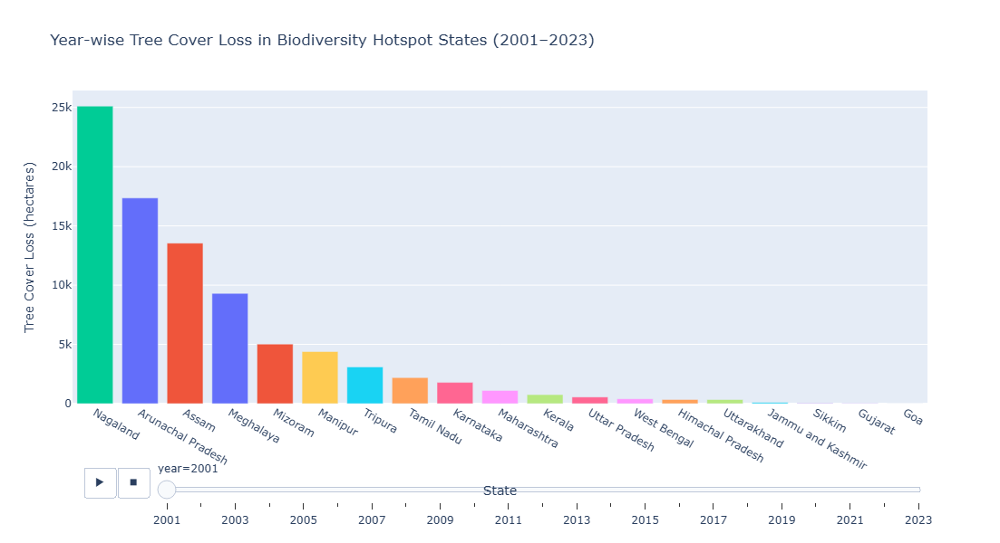

In [142]:
loss_cols = [col for col in hotspot_tree_loss.columns if col.startswith('tc_loss_ha_')]
# Reshaping wide dataframe to long format
loss_melted = hotspot_tree_loss.melt(
    id_vars=['subnational1'],
    value_vars=loss_cols,
    var_name='year',
    value_name='tree_loss'
)
# Clean 'year' column to extract just the year number (e.g., 2016)
loss_melted['year'] = loss_melted['year'].str.extract(r'(\d{4})').astype(int)

# Group by state and year (in case of duplicates)
loss_grouped = loss_melted.groupby(['year', 'subnational1'])['tree_loss'].sum().reset_index()

# Plot animated bar chart
fig = px.bar(
    loss_grouped,
    x='subnational1',
    y='tree_loss',
    color='subnational1',
    animation_frame='year',
    title='Year-wise Tree Cover Loss in Biodiversity Hotspot States (2001–2023)',
    labels={'subnational1': 'State', 'tree_loss': 'Tree Cover Loss (hectares)'},
)

# Customize layout
fig.update_layout(
    xaxis={'categoryorder': 'total descending'},
    yaxis_title='Tree Cover Loss (hectares)',
    xaxis_title='State',
    showlegend=False,
    height=600
)

fig.show()


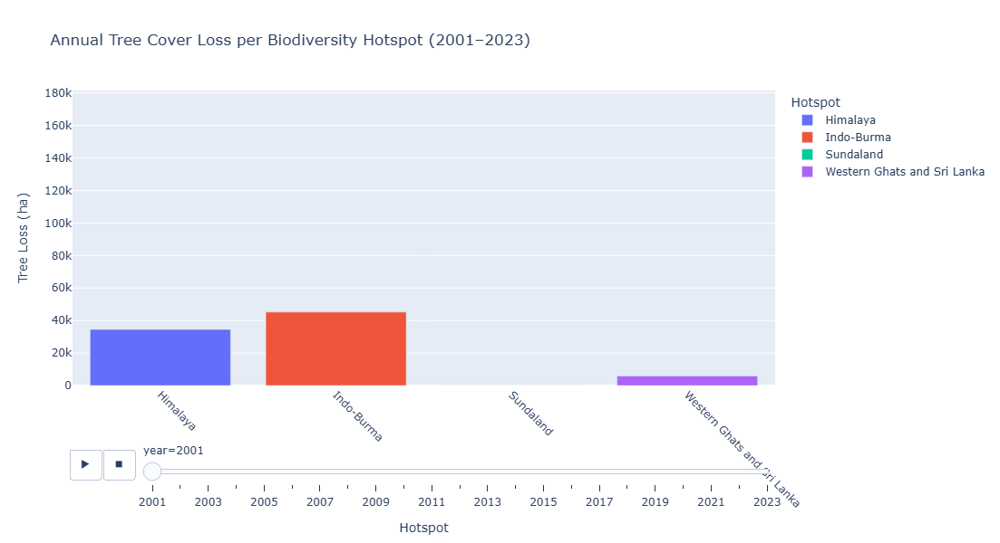

In [144]:

# Select loss columns
#loss_cols = [f"tc_loss_ha_{year}" for year in range(2001, 2024)]

# Melting the dataframe to long format
hotspot_melted = hotspot_tree_loss.melt(
    id_vars=["NAME"], 
    value_vars=loss_cols,
    var_name="year",
    value_name="tree_loss"
)

# Clean and convert year column
hotspot_melted["year"] = hotspot_melted["year"].str.extract(r"(\d+)").astype(int)

# Group by hotspot and year to aggregate tree loss
hotspot_summary = (
    hotspot_melted
    .groupby(["NAME", "year"])["tree_loss"]
    .sum()
    .reset_index()
    .rename(columns={"NAME": "Hotspot", "tree_loss": "Tree Loss (ha)"})
)

# Creating animated bar chart
fig = px.bar(
    hotspot_summary,
    x="Hotspot",
    y="Tree Loss (ha)",
    color="Hotspot",
    animation_frame="year",
    range_y=[0, hotspot_summary["Tree Loss (ha)"].max() * 1.1],
    title="Annual Tree Cover Loss per Biodiversity Hotspot (2001–2023)"
)

fig.update_layout(xaxis_tickangle=45, xaxis_title="Hotspot", yaxis_title="Tree Loss (ha)", height=600)
fig.show()


### Insights from Tree Cover Loss in Biodiversity Hotspot Regions
#### Folium Map + Animated Bar Graph (State-wise Tree Loss)

- The **Folium choropleth map** (based on 10% threshold) shows that **Northeastern states** like **Mizoram**, **Manipur**, **Nagaland**, **Arunachal**    Pradesh, and Assam consistently experience high percentages of forest loss. This confirms earlier observations and emphasizes the vulnerability of      these ecologically rich states.

- **Kerala** stands out as a **non-Northeastern** state that also shows considerable tree loss in some years, possibly due to **floods**, **landslides**, and urban expansion.

- States with **lower tree cover** loss don't necessarily imply healthier forests — in many cases, it suggests that these states already have **limited forest cover**, so even minor development or disaster events can lead to proportionally larger impacts.

- The animation across years allows us to **observe the temporal dynamics** — with Northeast states dominating tree loss across time, and the **intensity and fluctuation** of annual losses varying by region.

#### Animated Bar Graph (Hotspot-wise Tree Loss)
Among the four biodiversity hotspots in India:

- The **Indo-Burma hotspot** shows the **highest cumulative and annual tree loss**, driven by high-impact states like **Mizoram**, **Nagaland**, **Tripura**, and **Manipur**.

- The **Himalayan** and **Western Ghats** regions follow, showing **moderate but consistent** loss trends.

- The **Sundaland hotspot** (mainly the Nicobar Islands) shows **negligible tree loss**, likely due to its remote nature and protected status.

- This breakdown emphasizes that the **Indo-Burma** region is under the greatest **anthropogenic pressure**, warranting urgent **conservation attention**.

#### Key Observations
- **Natural disasters**, such as **floods, landslides, and forest fires**, have likely contributed to sharp spikes in annual loss.

- **Infrastructure development**, especially in ecologically fragile areas with steep terrain, can accelerate deforestation even when total forest area is small.

- States like **Sikkim**, despite sharing similar topography with other Northeastern states, have managed to **limit forest degradation**, showcasing the impact of **effective local policies and citizen-led conservation efforts**.









### SDG Connections:
This analysis directly aligns with the **Sustainable Development Goals (SDGs):**

**SDG 13 (Climate Action):**
Tree loss contributes to rising carbon emissions and reduces carbon sinks, impacting climate resilience.

**SDG 15 (Life on Land):**
Biodiversity hotspots are critical for ecosystem health. Forest degradation here endangers rare species and habitats.

**SDG 6 (Clean Water and Sanitation):**
Forests regulate watersheds. Loss affects water availability and quality in forest-dependent regions.

**SDG 11 (Sustainable Cities and Communities):**
Forests near urban centers provide clean air and reduce heat island effects. Deforestation risks sustainable urban growth.

## Climate Classification Change Analysis (Köppen-Geiger)

### Objective

This section aims to analyze how **climate zones across India have shifted over time** using the **Köppen-Geiger climate classification system**. By studying spatial and temporal changes in climate classes between **1901 and 2100**, we aim to uncover patterns of **climate transformation**, particularly within **ecologically sensitive regions** such as **biogeographic zones** and **biodiversity hotspots**. The analysis is crucial for informing climate adaptation strategies, conservation planning, and understanding ecological risk under different emissions scenarios.

---

### Data Preparation: Temporal Merging of Climate Classification Maps

The Köppen-Geiger datasets were originally available in **time-sliced GeoJSON files**, segmented into the following periods:

- **Historical Observations**:
  - 1901–1925
  - 1926–1950
  - 1951–1975
  - 1976–2000

- **Projected Climate Scenarios**:
  - A1FI (high-emissions): 2001–2025, 2026–2050, 2051–2075, 2076–2100
  - B1 (low-emissions): 2001–2025, 2026–2050, 2051–2075, 2076–2100

Each file includes polygons representing spatial extents of different **climate classes** (identified by a `GRIDCODE`).

To prepare the data:

- We **loaded each GeoJSON into a dictionary** for modular access.
- Two new columns were added:
  - `period` (e.g., "Historical",2001-2025-B1,2001-2025-A1FI, etc	)
  - `scenario` (e.g., "A1FI", "B1")
- All datasets were then **merged using `pd.concat()`** into a **single GeoDataFrame** to facilitate uniform spatial and temporal analysis.

This kind of structured merging and annotation represents a key **geospatial data engineering** step — transforming raw spatial datasets into a unified analytical framework.

---

Next, we begin analysis with the **historical period (1901–2000)**, tracking how climate zones have evolved over time at the national scale, then within **biogeographic zones**, and finally within **biodiversity hotspots**.


In [146]:


# Define file paths and organize by category
data_files = {
    "historical": ["C:/Users/shach/OneDrive/Desktop/LandSectorDataset/1901-1925.geojson", "C:/Users/shach/OneDrive/Desktop/LandSectorDataset/1926-1950.geojson", "C:/Users/shach/OneDrive/Desktop/LandSectorDataset/1951-1975.geojson", "C:/Users/shach/OneDrive/Desktop/LandSectorDataset/1976-2000.geojson"],
    "recent": [
     "C:/Users/shach/OneDrive/Desktop/LandSectorDataset/2001-2025-A1FI.geojson", 
 
     "C:/Users/shach/OneDrive/Desktop/LandSectorDataset/2001-2025-B1.geojson"  
    ],
    "intermediate":["C:/Users/shach/OneDrive/Desktop/LandSectorDataset/2051-2075-A1FI.geojson","C:/Users/shach/OneDrive/Desktop/LandSectorDataset/2051-2075-B1.geojson"],
    "future": [
        "C:/Users/shach/OneDrive/Desktop/LandSectorDataset/2076-2100-A1FI.geojson", 
       "C:/Users/shach/OneDrive/Desktop/LandSectorDataset/2076-2100-B1.geojson"
        
    ]
}

# Loading data into a dictionary

climate_data = {}




for category, files in data_files.items():
    frames = []
    for file in files:
        gdf = gpd.read_file(file)

        # Add info into the data itself:
        if "A1FI" in file:
            
            gdf["scenario"] = "A1FI"
        elif "B1" in file:
            gdf["scenario"] = "B1"
        else:
            gdf["scenario"] = "historical"

        gdf["period"] = file.split("/")[-1].replace(".geojson", "")
        frames.append(gdf)
    
    climate_data[category] = frames



print("Data Loaded Successfully!")


Data Loaded Successfully!


In [121]:
climate_data["intermediate"]

[      OBJECTID    ID  GRIDCODE  Shape_Length  Shape_Area  \
 0            1     1        62           2.0        0.25   
 1            2     2        61           3.0        0.50   
 2            3     3        61           2.0        0.25   
 3            4     4        61           3.0        0.50   
 4            5     5        61           2.0        0.25   
 ...        ...   ...       ...           ...         ...   
 2030      2031  2031        61           2.0        0.25   
 2031      2032  2032        61           2.0        0.25   
 2032      2033  2033        61           2.0        0.25   
 2033      2034  2034        61          14.0        6.75   
 2034      2035  2035        61        1127.0     6352.75   
 
                                                geometry scenario  \
 0     POLYGON ((-37.5 83.5, -37.5 84, -38 84, -38 83...     A1FI   
 1     POLYGON ((-75 82, -74 82, -74 82.5, -75 82.5, ...     A1FI   
 2     POLYGON ((-72 82, -72 82.5, -72.5 82.5, -72.5 ...   

In [148]:
all_gdfs = []

for category, gdf_list in climate_data.items():
    for gdf in gdf_list:
        gdf = gdf.copy()  # Avoid modifying original
        gdf["category"] = category  # Add the group: historical/recent/etc.
        all_gdfs.append(gdf)


# Combining all into one GeoDataFrame
combined_climate_df = gpd.GeoDataFrame(pd.concat(all_gdfs, ignore_index=True))


We are going to map **GRIDCODE** to climate class names:



In [150]:




# Creating the mapping dictionary
code_to_class = {
    11: "Af", 12: "Am", 13: "As", 14: "Aw",
    21: "BWk", 22: "BWh", 26: "BSk", 27: "BSh",
    31: "Cfa", 32: "Cfb", 33: "Cfc", 34: "Csa", 35: "Csb", 36: "Csc",  
    37: "Cwa", 38: "Cwb", 39: "Cwc",
    41: "Dfa", 42: "Dfb", 43: "Dfc", 44: "Dfd", 45: "Dsa", 46: "Dsb",

    
    47: "Dsc", 48: "Dsd", 49: "Dwa", 50: "Dwb", 51: "Dwc", 52: "Dwd",
    61: "EF", 62: "ET"
}


# Mapping the integer GRIDCODE to climate class names


combined_climate_df['climate_class'] = combined_climate_df['GRIDCODE'].map(code_to_class)

# Verify
print(combined_climate_df[['GRIDCODE', 'climate_class']].head(20))

combined_climate_df.to_file("combined_climate_data.geojson", driver='GeoJSON')


    GRIDCODE climate_class
0       62.0            ET
1       62.0            ET
2       62.0            ET
3       62.0            ET
4       62.0            ET
5       62.0            ET
6       61.0            EF
7       61.0            EF
8       61.0            EF
9       61.0            EF
10      62.0            ET
11      61.0            EF
12      61.0            EF
13      62.0            ET
14      61.0            EF
15      62.0            ET
16      62.0            ET
17      61.0            EF
18      62.0            ET
19      61.0            EF


## Köppen-Geiger Climate Classification: Explanation

This project uses the **Köppen-Geiger climate classification**, one of the most widely used systems to categorize world climates based on **temperature and precipitation patterns**. Each class reflects specific environmental and ecological conditions.

### Major Groups (First Letter)

| Code | Group              | Description                                                       |
|------|--------------------|-------------------------------------------------------------------|
| A    | Tropical            | Hot and humid, with average temperature > 18°C year-round         |
| B    | Dry                 | Arid or semi-arid, where evaporation exceeds precipitation        |
| C    | Temperate           | Moderate temperatures, with warm summers and cool winters         |
| D    | Cold (Continental)  | Cold winters, often snow-covered, with warm or short summers      |
| E    | Polar               | Extremely cold, with tundra or ice cap conditions                 |

---

### Subtypes (Second & Third Letters)

Each group is further broken down:

#### A – Tropical Climates
| Code | Name         | Description                                         |
|------|--------------|-----------------------------------------------------|
| Am   | Monsoon      | Heavy seasonal rainfall, short dry season           |
| Aw   | Savanna (dry winter) | Dry winters, wet summers — common in central/south India |
| As   | Savanna (dry summer) | Dry summers, wetter winters — less common            |

#### B – Dry Climates
| Code | Name         | Description                                         |
|------|--------------|-----------------------------------------------------|
| BWh  | Hot Desert   | Very arid and hot (e.g., Thar Desert)               |
| BWk  | Cold Desert  | Arid but cooler (e.g., Ladakh cold desert)          |
| BSh  | Hot Steppe   | Semi-arid, warm — common in central India           |
| BSk  | Cold Steppe  | Semi-arid, cooler — found in some elevated regions  |

#### C – Temperate (Subtropical)
| Code | Name         | Description                                         |
|------|--------------|-----------------------------------------------------|
| Cwa  | Dry Winter, Hot Summer | Common in northern plains (e.g., Delhi, Bihar)    |
| Cwb  | Dry Winter, Warm Summer | Hill regions (e.g., NE states, Western Ghats)   |
| Cfa  | Humid Subtropical | Rare — no dry season, hot summer                     |
| Cfb  | Oceanic       | Cooler, wetter year-round — rare in India             |
| Csa  | Mediterranean, hot summer | Mostly Western India (emerging with warming)     |
| Csb  | Mediterranean, warm summer | Very rare in India                          |

#### D – Cold Climates (Snow)
| Code | Name         | Description                                         |
|------|--------------|-----------------------------------------------------|
| Dfb  | Warm Summer | Cold winters, warm summers — parts of Himalayas     |
| Dfc  | Cool Summer | Cold & wet — high-altitude Himalayan areas          |
| Dwb  | Dry Winter  | Himalayan regions — cold & dry winters              |
| Dwc  | Dry Winter, Cool Summer | Similar, even colder — upper Himalayas         |
| Dsb  | Dry Summer, Warm Summer | Rare, cool climate with seasonal dryness       |
| Dsc  | Dry Summer, Cool Summer | Very rare, alpine regions                     |

#### E – Polar
| Code | Name         | Description                                         |
|------|--------------|-----------------------------------------------------|
| ET   | Tundra       | High Himalayas, permanently cold — very low vegetation |

---

### Why Does This Matter?

Each climate class affects:
- **Agriculture** – crop suitability and yields
- **Forests & biodiversity** – ecosystems and habitats
- **Human habitation & water availability**
- **Sensitivity to climate change**

In our analysis, we track **how these climate zones shift over time across India**, to detect trends such as:
- Warming (e.g., rise in `Aw`, `BSh`, fall in `ET`, `Cwa`)
- Drying or monsoon disruption
- Altitudinal or latitudinal migration of zones

This classification system is central to understanding both **past trends and future risks** in India's climate.


## Phase 1: Historical Climate Zone Analysis (1901–2000)

We begin by analyzing the historical Köppen-Geiger data across four 25-year intervals. This allows us to understand how climate zones have evolved prior to 2000—a crucial baseline for comparing future changes.

### Goals:
- Calculate the total area occupied by each climate class across time.
- Visualize how different climate zones have expanded or contracted during the 20th century.


In [156]:
# Ensuring both datasets use the same Coordinate Reference System
combined_climate_df = combined_climate_df.to_crs(country_boundaries.crs)

# Clipping climate classification data to India's boundary
climate_data_india = gpd.overlay(combined_climate_df, country_boundaries, how="intersection")



In [160]:
climate_data_india.head(5)

,OBJECTID,ID,GRIDCODE,Shape_Length,Shape_Area,scenario,period,category,climate_class,name,admin_level,geometry
0,1034,1034.0,26.0,2.0,0.25,historical,1901-1925,historical,BSk,India,2,"POLYGON ((74.5 36.5, 74 36.5, 74 36.83286, 74...."
1,1053,1053.0,21.0,6.0,1.25,historical,1901-1925,historical,BWk,India,2,"POLYGON ((73.5 36.5, 74 36.5, 74.5 36.5, 75 36..."
2,1076,1076.0,43.0,4.0,0.75,historical,1901-1925,historical,Dfc,India,2,"POLYGON ((73 36, 73 35.83904, 72.99803 35.8386..."
3,1077,1077.0,26.0,4.0,0.75,historical,1901-1925,historical,BSk,India,2,"POLYGON ((73 36, 74.5 36, 74.5 35.5, 73.80081 ..."
4,1126,1126.0,32.0,2.0,0.25,historical,1901-1925,historical,Cfb,India,2,"POLYGON ((73.5 34.5, 73.4352 34.5, 73.43526 34..."


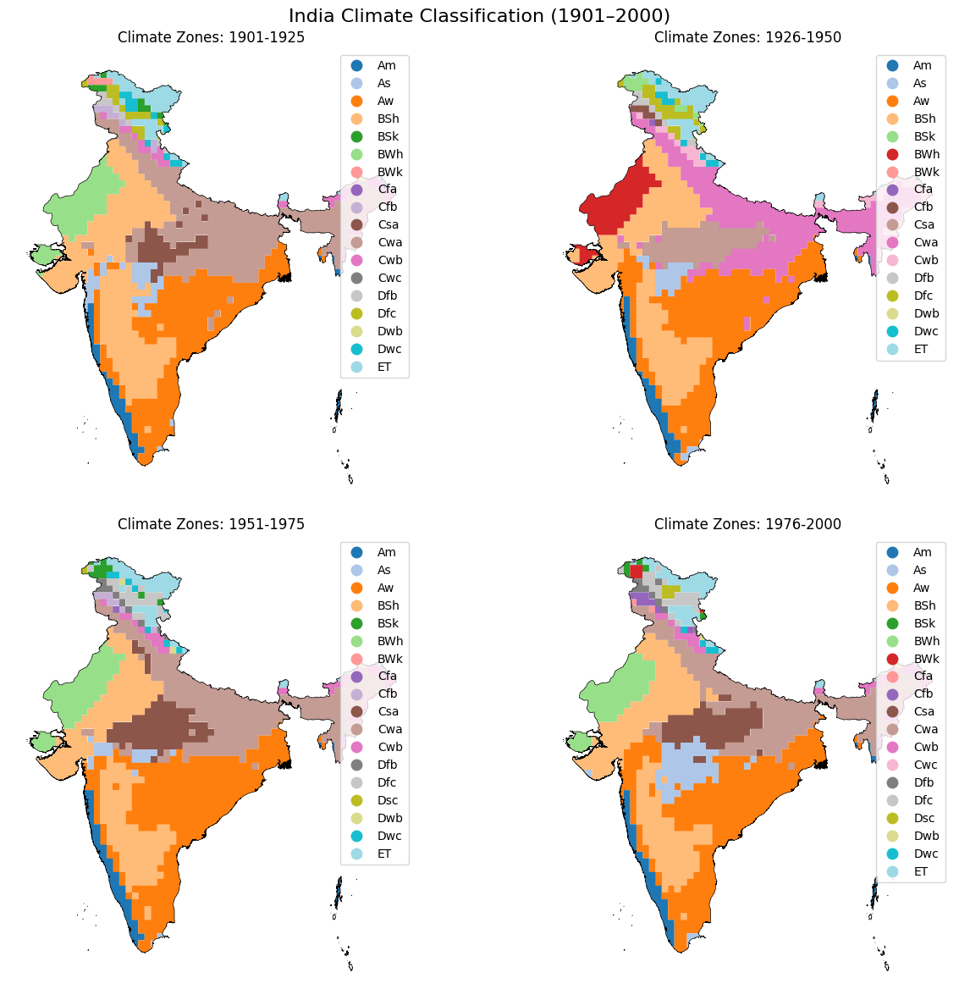

In [162]:
# Filter historical climate data
historical = climate_data_india[climate_data_india["category"] == "historical"]
historical_periods = sorted(historical["period"].unique())

# Plot 25-year intervals
fig, axs = plt.subplots(2, 2, figsize=(14, 12))
for ax, period in zip(axs.flat, historical_periods):
    subset = historical[historical["period"] == period]
    subset.plot(column="climate_class", cmap="tab20", ax=ax, legend=True)
    country_boundaries.boundary.plot(ax=ax, color="black", linewidth=0.5)
    ax.set_title(f"Climate Zones: {period}")
    ax.axis("off")
    

plt.suptitle("India Climate Classification (1901–2000)", fontsize=16)

plt.tight_layout()
plt.show()


## Climate Class Area Calculations (Historical Data)

We reprojected the dataset to an equal-area projection (EPSG:6933) to ensure accurate area calculations in square kilometers. The area of each polygon is then grouped by time period and climate class to create a summary table.

This forms the foundation for calculating net changes, plotting stacked area charts, and generating pivot tables.


In [164]:
climate_data_india_m = climate_data_india.to_crs(epsg=6933)  # Cylindrical Equal Area (worldwide)



In [166]:
# Filter historical data (1901–2000)
historical_data = climate_data_india_m[climate_data_india_m["category"] == "historical"].copy()






In [103]:
historical_data

,OBJECTID,ID,GRIDCODE,Shape_Length,Shape_Area,scenario,period,category,climate_class,name,admin_level,geometry
0,1034,1034.0,26.0,2.0,0.25,historical,1901-1925,historical,BSk,India,2,"POLYGON ((7188227.879 4354684.274, 7139984.739..."
1,1053,1053.0,21.0,6.0,1.25,historical,1901-1925,historical,BWk,India,2,"POLYGON ((7091741.598 4354684.274, 7139984.739..."
2,1076,1076.0,43.0,4.0,0.75,historical,1901-1925,historical,Dfc,India,2,"POLYGON ((7043498.458 4303002.386, 7043498.458..."
3,1077,1077.0,26.0,4.0,0.75,historical,1901-1925,historical,BSk,India,2,"POLYGON ((7043498.458 4303002.386, 7188227.879..."
4,1126,1126.0,32.0,2.0,0.25,historical,1901-1925,historical,Cfb,India,2,"POLYGON ((7091741.598 4146035.161, 7085489.304..."
...,...,...,...,...,...,...,...,...,...,...,...,...
330,1593,1593.0,12.0,32.0,10.75,historical,1976-2000,historical,Am,India,2,"MULTIPOLYGON (((7188227.879 1953977.982, 71882..."
331,1603,1603.0,14.0,89.0,76.00,historical,1976-2000,historical,Aw,India,2,"MULTIPOLYGON (((7525929.86 1206547.479, 752592..."
332,1606,1606.0,13.0,13.0,4.50,historical,1976-2000,historical,As,India,2,"MULTIPOLYGON (((7525929.86 1080505.096, 752592..."
333,1633,1633.0,12.0,68.0,29.75,historical,1976-2000,historical,Am,India,2,"MULTIPOLYGON (((8973224.063 2739869.868, 89732..."


In [168]:
# Ensure the area column exists (in degrees, or reproject to meters if needed)

historical_data["climate_area"] = historical_data.geometry.area  
historical_data["climate_area_km2"] = historical_data["climate_area"] / 1e6

# Group by period and climate_class, then sum areas
climate_area_by_period = (
    historical_data.groupby(["period", "climate_class"])["climate_area_km2"]
    .sum()
    .reset_index()
)


In [170]:
climate_area_by_period


,period,climate_class,climate_area_km2
0,1901-1925,Am,92601.296576
1,1901-1925,As,106006.092057
2,1901-1925,Aw,748841.520945
3,1901-1925,BSh,806089.989666
4,1901-1925,BSk,19399.547621
...,...,...,...
67,1976-2000,Dfc,58691.858690
68,1976-2000,Dsc,12727.266235
69,1976-2000,Dwb,4103.845802
70,1976-2000,Dwc,11050.020895


In [172]:
# Pivot the data to get climate classes as rows and periods as columns
pivot_table = climate_area_by_period.pivot_table(
    index="climate_class",
    columns="period",
    
    values="climate_area_km2",
    
    fill_value=0

    
)

# reordering columns
pivot_table = pivot_table[["1901-1925", "1926-1950", "1951-1975", "1976-2000"]]


In [174]:
pivot_table


period,1901-1925,1926-1950,1951-1975,1976-2000
climate_class,,,,
Am,92601.296576,100659.342483,106476.889005,99796.638480
As,106006.092057,72044.007151,54027.338004,183024.232148
Aw,748841.520945,886655.643589,913791.507918,878346.704844
BSh,806089.989666,712408.603022,692458.637221,703047.003839
BSk,19399.547621,27766.732129,21863.270738,11859.653436
BWh,215543.811450,193602.396588,211392.396915,202230.140313
BWk,10973.002902,66.364126,66.364126,10868.072167
Cfa,199.412471,2583.858004,2783.270475,4924.820832
Cfb,20689.770051,15379.907820,18049.480376,20618.733658


In [176]:
# Calculate net change (last - first)
pivot_table["net_change"] = pivot_table["1976-2000"] - pivot_table["1901-1925"]

# Sort by net change
pivot_table_sorted = pivot_table.sort_values("net_change", ascending=False)


# Display or save


print(pivot_table_sorted)


period             1901-1925      1926-1950      1951-1975      1976-2000  \
climate_class                                                               
Aw             748841.520945  886655.643589  913791.507918  878346.704844   
Csa            115327.164980  250035.174843  240604.274155  215848.664213   
As             106006.092057   72044.007151   54027.338004  183024.232148   
Dfc             38645.553945   56284.777666   56152.087876   58691.858690   
Dsc                 0.000000       0.000000    2301.575970   12727.266235   
Am              92601.296576  100659.342483  106476.889005   99796.638480   
Cfa               199.412471    2583.858004    2783.270475    4924.820832   
Dwb              2743.763069    2743.763069    7935.325478    4103.845802   
Dfb             19847.681934   22474.163610   22460.155061   21011.861125   
Cwb             97396.036832   97891.618125   98565.666996   97467.073224   
Cwc              1169.630164       0.000000       0.000000    1169.630164   

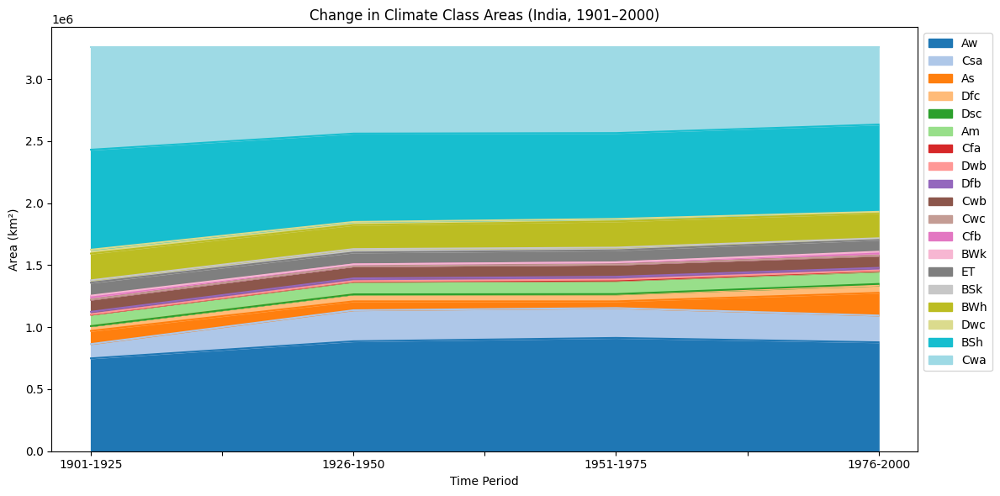

In [178]:

# Transpose for plotting
area_df = pivot_table_sorted.drop(columns="net_change").T

# Plot
area_df.plot(kind="area", stacked=True, colormap="tab20", figsize=(12, 6))
plt.title("Change in Climate Class Areas (India, 1901–2000)")
plt.xlabel("Time Period")

plt.ylabel("Area (km²)")
plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()


In [180]:
# Filtering historical data
historical = climate_data_india[climate_data_india["category"] == "historical"]
historical_periods = sorted(historical["period"].unique())

# Preparing dictionary of period-wise GeoDataFrames
period_dict = {
    period: historical[historical["period"] == period]
    for period in historical_periods
}

#  Assign colors to unique climate classes
all_codes = sorted(historical["climate_class"].unique())
colormap = colormaps.get_cmap("tab20").resampled(len(all_codes))
code_color_dict = {
    code: mcolors.rgb2hex(colormap(i)) for i, code in enumerate(all_codes)
}

# Dropdown and output area
dropdown = widgets.Dropdown(
    options=historical_periods,
    value=historical_periods[0],
    description="Period:"
)
map_display = widgets.Output()

# Update map function
def update_map(change):
    map_display.clear_output()
    period = change["new"]
    gdf_data = period_dict[period]

    m = folium.Map(location=[22, 80], zoom_start=4, tiles="CartoDB positron")

    # Add climate layer with tooltip
    folium.GeoJson(
        gdf_data,
        name=f"Climate {period}",
        style_function=lambda feature: {
            "fillColor": code_color_dict[feature["properties"]["climate_class"]],
            "color": "black",
            "weight": 0.3,
            "fillOpacity": 0.7,
        },
        tooltip=folium.GeoJsonTooltip(
            fields=["climate_class"],
            aliases=["Köppen Class:"],
            sticky=True  # Ensures tooltip follows the mouse
        )
    ).add_to(m)

    # Add India boundary layer
    folium.GeoJson(
        country_boundaries,
        name="India Boundary",
        style_function=lambda x: {
            "color": "black",
            "weight": 1,
            "fillOpacity": 0
        }
    ).add_to(m)
    
    folium.LayerControl(collapsed=False).add_to(m)
    with map_display:
        display(m)

# Step 6: Bind and show
dropdown.observe(update_map, names="value")
display(dropdown)
update_map({"new": historical_periods[0]})
display(map_display)



Dropdown(description='Period:', options=('1901-1925', '1926-1950', '1951-1975', '1976-2000'), value='1901-1925…

Output()

### Interpretation: Historical Climate Shifts in India (1901–2000)

This analysis captures how India's climate zones evolved over the 20th century, based on the Köppen-Geiger classification data. The net area change for each climate class between 1901 and 2000 reveals several significant trends:

- **Tropical savanna (Aw)** increased dramatically by **+129,505 km²**, suggesting a widespread expansion of drier, open vegetation areas across central and peninsular India.
- **Monsoonal (As)** and **Tropical monsoon (Am)** zones also expanded by **+77,018 km²** and **+7,195 km²** respectively, indicating greater spatial spread of seasonal rainfall patterns in some regions.
- **Cold climates** such as **Dfc, Dsc, Dfb, Dwb** showed moderate gains, reflecting upward or poleward shifts in Himalayan and sub-Himalayan zones:
  - Dfc: +20,046 km²  
  - Dsc: +12,727 km²  
  - Dfb: +1,164 km²  
  - Dwb: +1,360 km²
- **Dry climates**, especially **semi-arid (BSh)** and **arid desert (BWh)** zones, showed significant **losses**:
  - BSh decreased by **–103,043 km²**  
  - BWh shrank by **–13,314 km²**
- **Humid subtropical (Cwa)** saw the **largest contraction**, shrinking by **–202,609 km²** — a major signal of reduced rainfall or rising temperatures in northern and northeastern India.
- **Alpine (ET)** and **dry-cold (Dwc)** zones declined by **–7,520 km²** and **–20,133 km²** respectively, possibly due to warming temperatures at higher elevations.

### What Does It Mean?

These shifts suggest that India experienced:
- A **poleward and altitudinal shift** in climate zones — warmer and drier zones expanded into areas that were historically cooler or wetter.
- A **contraction of humid and sub-humid zones**, which has implications for **agriculture, water availability, and biodiversity**.
- Climate classes critical for sensitive ecosystems and human livelihoods (like Cwa, BSh, ET) **receded**, potentially increasing **ecological vulnerability** and stress on **resource-dependent communities**.

This baseline (1901–2000) sets the stage for comparing **recent (2001–2025)** and **future projected changes** (2026–2100) under different emission scenarios.


## Phase 2: Climate Zones vs Biogeographic Zones

India's biogeographic zones are ecologically meaningful regional divisions used in conservation and ecological studies. Overlaying climate data on these zones helps us assess climate change impact at the ecosystem level.

### Goals:
- Calculate area of each climate class within each biogeographic zone.
- Compare changes over time and across different future scenarios.


### Methodology:
- We use **`GeoPandas.overlay()`** to spatially intersect the climate classification data with biogeographic zone boundaries.
- The resulting dataset will allow us to calculate the **area (in km²)** of each climate class **within each biozone**, over different **time periods** and **scenarios**.
- A function has been created to:
  - Take user inputs: `scenario` (e.g., *historical*, *A1FI*, *B1*) and `period` (e.g., *1901–1925*, *2001–2025-B1,*2001-2025-A1FI*)
  - Output: A **heatmap** visualizing the area of each climate class across biozones for the selected scenario and period.


In [181]:
biozones = gpd.read_file("C:/Users/shach/Downloads/lyr_76_india_biogeographic/lyr_76_india_biogeographic.shp")
biozones.set_crs(epsg=4326, inplace=True)
# Reproject to match climate data CRS

biozones_proj = biozones.to_crs(climate_data_india_m.crs)



In [183]:


# One-time overlay of climate and biozones
climate_bio_intersect_all = gpd.overlay(climate_data_india_m, biozones_proj, how="intersection")

# Calculate area once
climate_bio_intersect_all["area_km2"] = climate_bio_intersect_all.geometry.area / 1e6



In [185]:
def analyze_climate_biozones_overlayed(intersect_all, scenario, period, zone_col="biogeozone"):
    # Subset for given scenario and period
    subset = intersect_all[
        (intersect_all["scenario"] == scenario) &
        (intersect_all["period"] == period)
    ].copy()

    if subset.empty:
        print(f" No data for {scenario} - {period}")
        return None

    # Group by biozone and climate class
    summary = (
        subset.groupby([zone_col, "climate_class"])["area_km2"]
        .sum()
        .reset_index()
    )

    # Pivot for heatmap
    pivot = summary.pivot(index=zone_col, columns="climate_class", values="area_km2").fillna(0)

    #  Heatmap
    plt.figure(figsize=(12, 7))
    sns.heatmap(pivot, cmap="YlGnBu", annot=False, linewidths=0.5)
    plt.title(f"Heatmap: Climate Area per Biozone ({scenario} - {period})")
    plt.xlabel("Climate Class")
    plt.ylabel("Biogeographic Zone")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

    # Stacked area plot
    pivot_plot = pivot.T
    pivot_plot.plot(kind="area", stacked=True, figsize=(12, 6), colormap="tab20c", alpha=0.9)
    plt.title(f"Stacked Area Plot: Climate Composition per Biozone ({scenario} - {period})")
    plt.xlabel("Climate Class")
    plt.ylabel("Area (km²)")
    plt.legend(title=zone_col, bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

    return summary


In [187]:

def manual_query_mode():
    scenario = input("Enter scenario (e.g., historical, A1FI, B1): ").strip()
    period = input("Enter period (e.g., 1901-1925, 2001-2025-A1FI,2001-2025-B1,etc): ").strip()

    analyze_climate_biozones_overlayed(
        intersect_all=climate_bio_intersect_all,
        scenario=scenario,
        period=period
    )


Enter scenario (e.g., historical, A1FI, B1):  B1
Enter period (e.g., 1901-1925, 2001-2025-A1FI,2001-2025-B1,etc):  2001-2025-B1


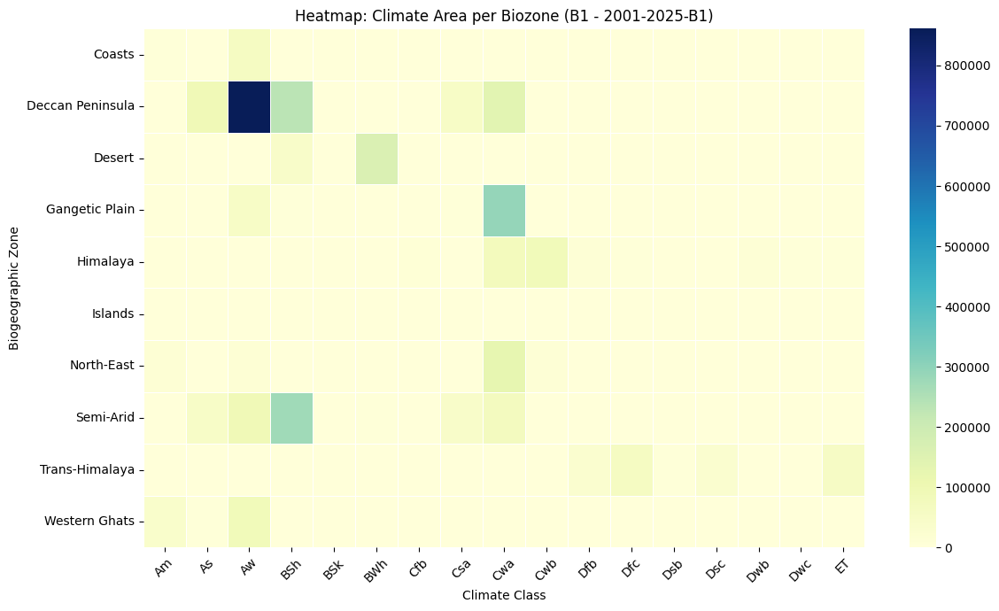

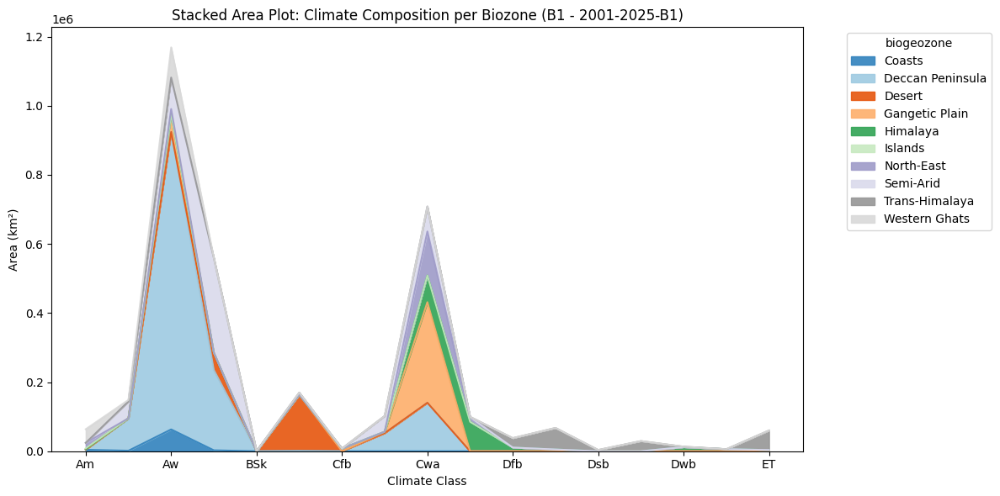

In [189]:
manual_query_mode()

In [191]:


# Group by time interval, climate class, and zone
biozone_climate_summary = (
    climate_bio_intersect_all
    .groupby(["period", "climate_class", "biogeozone"])["area_km2"]
    .sum()
    .reset_index()
)


In [193]:
biozone_climate_summary


,period,climate_class,biogeozone,area_km2
0,1901-1925,Am,Coasts,7153.027519
1,1901-1925,Am,Deccan Peninsula,3833.952023
2,1901-1925,Am,Islands,3747.996855
3,1901-1925,Am,North-East,3810.643886
4,1901-1925,Am,Western Ghats,73108.792204
...,...,...,...,...
504,2076-2100-B1,Dwb,Trans-Himalaya,1833.010464
505,2076-2100-B1,Dwc,Himalaya,5702.842805
506,2076-2100-B1,Dwc,Trans-Himalaya,11935.610116
507,2076-2100-B1,ET,Himalaya,1256.901867


In [195]:
# Filter for North-East biogeographic zone
northeast_zone_data = climate_bio_intersect_all[
    climate_bio_intersect_all["biogeozone"].str.contains("North-East", case=False)
]

# Group by climate class and sum area
northeast_climate_summary = (
    northeast_zone_data.groupby(["climate_class","period","scenario"])["area_km2"]
    .sum()
    .sort_values()
    .reset_index()
)

# Print the result
print(northeast_climate_summary)


   climate_class          period    scenario       area_km2
0             Am       1926-1950  historical    1698.195941
1             Am       1951-1975  historical    1698.195941
2            Cwb    2051-2075-B1          B1    3211.740295
3            Cwb    2076-2100-B1          B1    3211.740295
4             Aw       1976-2000  historical    3306.886448
5             Aw       1926-1950  historical    3306.886448
6             Aw       1951-1975  historical    3306.886448
7             Aw       1901-1925  historical    3428.923126
8             Am       1901-1925  historical    3810.643886
9             Am       1976-2000  historical    3810.643886
10            Aw  2076-2100-A1FI        A1FI   11432.140875
11           Cwb    2001-2025-B1          B1   13218.189479
12            Aw    2051-2075-B1          B1   13792.302475
13            Aw    2001-2025-B1          B1   14327.175303
14            Am    2001-2025-B1          B1   15821.863612
15            Am  2001-2025-A1FI        

In [197]:
# List of (period, scenario) pairs to analyze
target_periods = [
    ("1976-2000", "historical"),
    ("2001-2025-A1FI", "A1FI"),
    ("2001-2025-B1", "B1"),
    ("2076-2100-A1FI", "A1FI"),
    ("2076-2100-B1", "B1")
]

# Initializing dictionary to store dominant class per biozone and period-scenario
dominant_classes = {}

# Loop through each (period, scenario) pair
for period, scenario in target_periods:
    # Filter data
    df_filtered = climate_bio_intersect_all[
        (climate_bio_intersect_all["period"] == period) &
        (climate_bio_intersect_all["scenario"] == scenario)
    ]
    
    # Group by biozone and climate class, sum area
    summary = (
        df_filtered.groupby(["biogeozone", "climate_class"])["area_km2"]
        .sum()
        .reset_index()
    )

    # For each biozone, find the class with max area
    max_per_zone = summary.loc[summary.groupby("biogeozone")["area_km2"].idxmax()]

    # Add to dictionary with period-scenario as column name
    col_name = f"{period}"
    dominant_classes[col_name] = max_per_zone.set_index("biogeozone")["climate_class"]

# Combine all into a single DataFrame
dominant_df = pd.DataFrame(dominant_classes)
dominant_df.reset_index(inplace=True)
dominant_df.columns.name = None  # remove index name for clean display

# Display the result
dominant_df


,biogeozone,1976-2000,2001-2025-A1FI,2001-2025-B1,2076-2100-A1FI,2076-2100-B1
0,Coasts,Aw,Aw,Aw,Aw,Aw
1,Deccan Peninsula,Aw,Aw,Aw,Aw,Aw
2,Desert,BWh,BWh,BWh,BWh,BWh
3,Gangetic Plain,Cwa,Cwa,Cwa,Aw,Aw
4,Himalaya,Cwb,Cwb,Cwb,Cwa,Cwa
5,Islands,Am,Am,Am,Am,Am
6,North-East,Cwa,Cwa,Cwa,Am,Cwa
7,Semi-Arid,BSh,BSh,BSh,As,BSh
8,Trans-Himalaya,ET,Dfc,Dfc,Dsc,Dsc
9,Western Ghats,Am,Aw,Aw,Aw,Aw


In [199]:
def dominant_class_change_across_biozones(dominant_df, 
                                          period_ref="2001-2025-A1FI", 
                                          period_future="2076-2100-A1FI", 
                                          scenario="A1FI"):

    """
    We have to calculate the change in area of the dominant climate class (from reference period)
    in each biogeographic zone by the future period.

    Parameters:
        dominant_df (DataFrame): DataFrame containing precomputed dominant classes for each biozone.
                                 Should include columns 'biogeozone' and the reference period name.
        period_ref (str): The reference period (must match column name in dominant_df).
        period_future (str): The future period to compare.
        scenario (str): Climate scenario to filter on (e.g., 'A1FI').

    Returns:
        DataFrame with columns:
        ['biogeozone', 'dominant_class', 'area_in_ref_period', 'area_in_future', 'net_change']
    """

    # Creating lookup of dominant class from provided table
    ref_dominant = dominant_df[["biogeozone", period_ref]].rename(
        columns={period_ref: "dominant_class"}
    )

    # Get area of dominant class in reference period
    df_ref = climate_bio_intersect_all[
        (climate_bio_intersect_all["period"] == period_ref) &
        (climate_bio_intersect_all["scenario"] == scenario)
    ]
    ref_area = (
        df_ref.groupby(["biogeozone", "climate_class"])["area_km2"]
        .sum()
        .reset_index()
    )
    # Merge to get area of the dominant class only
    ref_merged = pd.merge(
        ref_dominant, ref_area,
        left_on=["biogeozone", "dominant_class"],
        right_on=["biogeozone", "climate_class"],
        how="left"
    ).rename(columns={"area_km2": "area_in_ref_period"})

    # Get area of same dominant class in future period
    df_future = climate_bio_intersect_all[
        (climate_bio_intersect_all["period"] == period_future) &
        (climate_bio_intersect_all["scenario"] == scenario)
    ]
    future_area = (
        df_future.groupby(["biogeozone", "climate_class"])["area_km2"]
        .sum()
        .reset_index()
        .rename(columns={"area_km2": "area_in_future"})
    )

    # Merge future area with the same dominant class
    final = pd.merge(
        ref_merged, future_area,
        left_on=["biogeozone", "dominant_class"],
        right_on=["biogeozone", "climate_class"],
        how="left"
    )

    # Fill NA and compute net change
    final["area_in_future"] = final["area_in_future"].fillna(0)
    final["net_change"] = final["area_in_future"] - final["area_in_ref_period"]

    # Final cleanup
    result = final[["biogeozone", "dominant_class", "area_in_ref_period", "area_in_future", "net_change"]].round(2)

    return result


In [201]:
result_df = dominant_class_change_across_biozones(dominant_df)
display(result_df)


,biogeozone,dominant_class,area_in_ref_period,area_in_future,net_change
0,Coasts,Aw,63067.75,61091.99,-1975.76
1,Deccan Peninsula,Aw,835591.18,1004754.26,169163.07
2,Desert,BWh,168166.42,109223.18,-58943.24
3,Gangetic Plain,Cwa,288248.83,5789.61,-282459.22
4,Himalaya,Cwb,87576.46,64244.46,-23332.00
5,Islands,Am,3748.00,3748.00,0.00
6,North-East,Cwa,120895.84,24032.49,-96863.35
7,Semi-Arid,BSh,281209.29,186177.65,-95031.65
8,Trans-Himalaya,Dfc,59749.72,0.00,-59749.72
9,Western Ghats,Aw,84580.47,83616.58,-963.89


#### Animated Climate Class Area Change (Per Biogeographic Zone):
This animation shows how different climate classes (e.g., Cwa, Aw, BSh) have changed in area over time within a selected biogeographic zone — here, the Gangetic Plain.
Each frame represents a time period from 1901 to 2100 (historical + projected), and each bar shows the total area (km²) under a climate class during that time.

This helps us:
- Track dominant climate shifts over time.
- Identify expanding or shrinking climate zones.
- Visually compare climate transformation under different scenarios.
  
We can change the zone by editing: zone = "Gangetic Plain"

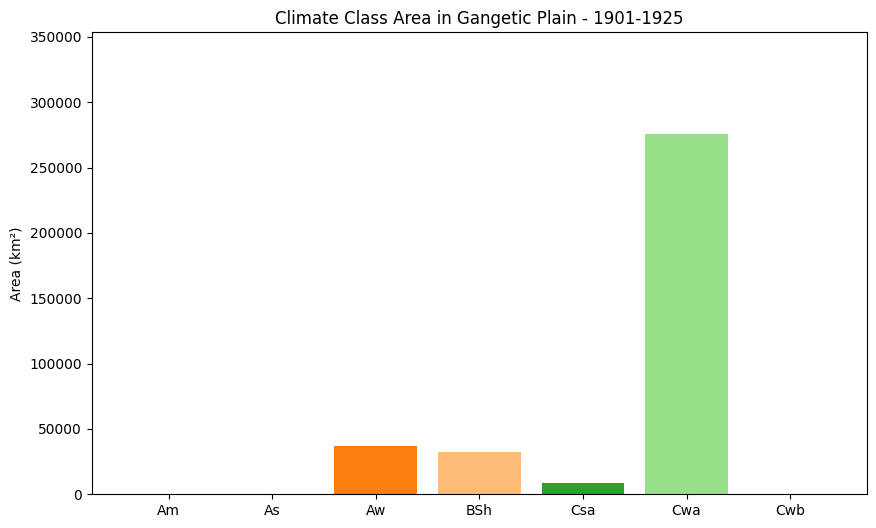

In [203]:

import matplotlib.animation as animation

# We can replace 'Western Ghats' with any biogeozone we want to visualize
zone = "Gangetic Plain"

# Filtering for the selected zone
zone_data = climate_bio_intersect_all[climate_bio_intersect_all["biogeozone"] == zone]

# Group and summarize area per climate class and period
zone_summary = (
    zone_data.groupby(["period", "climate_class"])["area_km2"]
    .sum()
    .reset_index()
)

# Pivot to get periods as rows, climate classes as columns
pivot_df = zone_summary.pivot(index="period", columns="climate_class", values="area_km2").fillna(0)
pivot_df = pivot_df.sort_index()

# Setup for animated bar chart
fig, ax = plt.subplots(figsize=(10, 6))
colors = plt.cm.tab20.colors
bars = ax.bar(pivot_df.columns, pivot_df.iloc[0], color=colors[:len(pivot_df.columns)])
title = ax.set_title(f"Climate Class Area in {zone} - {pivot_df.index[0]}")
ax.set_ylabel("Area (km²)")
ax.set_ylim(0, pivot_df.values.max() * 1.1)

# Update function for each frame
def update(frame):
    for bar, new_height in zip(bars, pivot_df.iloc[frame]):
        bar.set_height(new_height)
    title.set_text(f"Climate Class Area in {zone} - {pivot_df.index[frame]}")
    return bars

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=len(pivot_df), repeat=False, blit=False)

# To display in notebook
from IPython.display import HTML
HTML(ani.to_jshtml())


### Climate Shifts Across India's Biogeographic Zones 

By analyzing both **heatmaps** and **tabular summaries**, we uncover a clear story of transformation in India's climate geography under the high-emissions A1FI scenario.

#### Key Insights:

- **Tropical Savanna (Aw)** remains the dominant climate class in the **Coasts, Deccan Peninsula, and Western Ghats**, with relatively minor losses or even slight gains in area. These zones appear more **climate-resilient** under the current trajectory.
  
- The **Desert zone** retains its **BWh (Hot Desert)** classification, but sees a **loss of over 58,000 km²**, suggesting **micro-level shifts** or potential encroachment by other dry climate types.

- The **Gangetic Plain** undergoes a dramatic shift: the previously dominant **Cwa (Dry Winter, Hot Summer)** climate collapses, with its area shrinking by **~282,000 km²**. It is replaced by **Aw (Tropical Savanna)**, marking a worrying transition toward **hotter and potentially drier conditions** in one of India’s most fertile and populous regions.

- In the **North-East**, **Cwa** also loses ~96,000 km², making way for **Am (Tropical Monsoon)**. This could signal an **increase in precipitation extremes** or monsoonal intensity in a biodiversity-rich and sensitive region.

- The **Himalayan zone**, historically dominated by **Cwb (Cool, Dry Winter)**, sees a transition toward **Cwa** as well, pointing to **warming at higher altitudes** — a classic signal of climate change.

- In the **Trans-Himalayas**, the **Dfc (Snow, Cold Summer)** climate vanishes completely, replaced by **Dsc (Snow, Dry Summer)** — another marker of **temperature rise and changing seasonal patterns** in extreme northern highlands.

- **Semi-Arid regions** witness a change in dominant class from **BSh to As** (Tropical Summer Dry), with a substantial **loss of ~95,000 km²** in BSh area — indicating more tropical and less arid conditions emerging in what were once drier tracts.

- The **Islands** are an exception, maintaining their **Am (Tropical Monsoon)** climate with **no change in dominant class or area**, perhaps due to their ocean-buffered microclimate stability.

---

These insights, combining **visual diagnostics** (heatmaps) with **quantified evidence** (tables), offer a robust understanding of **how and where India's ecological zones are shifting** — with significant implications for biodiversity, agriculture, water security, and climate adaptation policies.


In [205]:
biozone_climate_summary

,period,climate_class,biogeozone,area_km2
0,1901-1925,Am,Coasts,7153.027519
1,1901-1925,Am,Deccan Peninsula,3833.952023
2,1901-1925,Am,Islands,3747.996855
3,1901-1925,Am,North-East,3810.643886
4,1901-1925,Am,Western Ghats,73108.792204
...,...,...,...,...
504,2076-2100-B1,Dwb,Trans-Himalaya,1833.010464
505,2076-2100-B1,Dwc,Himalaya,5702.842805
506,2076-2100-B1,Dwc,Trans-Himalaya,11935.610116
507,2076-2100-B1,ET,Himalaya,1256.901867


## Phase 3: Climate Analysis in India's Biodiversity Hotspots

India is home to four globally recognized **biodiversity hotspots** — the **Himalaya**, **Indo-Burma (North-East)**, **Western Ghats**, and **Sundaland (Islands)**. These regions are ecologically fragile, rich in endemic species, and highly sensitive to climatic shifts.

In this phase, we aim to explore how climate zones have evolved within these hotspots over time using **Köppen-Geiger climate classification** data. We specifically examine:

- The **distribution of climate classes** in each hotspot across historical, recent, intermediate, and future periods.
- The **dominant climate class** in each hotspot during the reference period (2001–2025, A1FI).
- The **area change** of these dominant climate classes under the future scenario (2076–2100, A1FI).
- Heatmaps showing the **area of each climate class per hotspot** across multiple time slices.

This analysis helps us understand:
- **Which climate zones are expanding or shrinking within ecologically critical areas.**
- How climate shifts might alter the **habitats and ecological integrity** of these hotspots.
- Where **policy and conservation efforts** might need to be intensified in a warming climate.

The approach closely follows our previous steps for biogeographic zones — but here, the focus is sharper, as these regions hold **unique biodiversity** and **conservation value**.


In [207]:
# One-time overlay of climate and hotspots
climate_hotspot_intersect_all = gpd.overlay(climate_data_india_m, hotspots_proj, how="intersection")

In [209]:
climate_hotspot_intersect_all["area_km2"] = climate_hotspot_intersect_all.geometry.area / 1e6


In [211]:
climate_hotspot_intersect_all[climate_hotspot_intersect_all["NAME"]=="Himalaya"]

,OBJECTID_1,ID,GRIDCODE,Shape_Length_1,Shape_Area_1,scenario,period,category,climate_class,name_1,...,enname,locname,offname,boundary,adminlevel,wikidata,wikimedia,hotspot_area,geometry,area_km2
0,1127,1127.0,42.0,7.0,1.75,historical,1901-1925,historical,Dfb,India,...,Jammu and Kashmir,Jammu and Kashmir,,administrative,4,Q1180,en:Jammu and Kashmir,4.051811e+10,"POLYGON ((7236471.019 4146035.161, 7129456.636...",2309.001081
1,1128,1128.0,43.0,5.0,1.25,historical,1901-1925,historical,Dfc,India,...,Jammu and Kashmir,Jammu and Kashmir,,administrative,4,Q1180,en:Jammu and Kashmir,4.051811e+10,"POLYGON ((7236471.019 4161437.688, 7236501.46 ...",462.517253
2,1147,1147.0,42.0,2.0,0.25,historical,1901-1925,historical,Dfb,India,...,Jammu and Kashmir,Jammu and Kashmir,,administrative,4,Q1180,en:Jammu and Kashmir,4.051811e+10,"POLYGON ((7236471.019 4146035.161, 7271192.258...",2421.296387
3,1148,1148.0,43.0,2.0,0.25,historical,1901-1925,historical,Dfc,India,...,Jammu and Kashmir,Jammu and Kashmir,,administrative,4,Q1180,en:Jammu and Kashmir,4.051811e+10,"POLYGON ((7284714.159 4127944.404, 7285129.337...",732.024259
4,1149,1149.0,51.0,6.0,1.50,historical,1901-1925,historical,Dwc,India,...,Jammu and Kashmir,Jammu and Kashmir,,administrative,4,Q1180,en:Jammu and Kashmir,4.051811e+10,"MULTIPOLYGON (((7332957.299 4101678.857, 73331...",69.764578
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
944,1518,1518.0,12.0,56.0,27.75,B1,2076-2100-B1,future,Am,India,...,Bihar,Bihar,,administrative,4,Q1165,en:Bihar,3.854893e+09,"POLYGON ((8490792.662 3249090.04, 8490803.941 ...",238.608066
945,1518,1518.0,12.0,56.0,27.75,B1,2076-2100-B1,future,Am,India,...,Meghalaya,Meghalaya,,administrative,4,Q1195,en:Meghalaya,8.277240e+06,"MULTIPOLYGON (((8674605.896 3174756.195, 86739...",8.277240
946,1518,1518.0,12.0,56.0,27.75,B1,2076-2100-B1,future,Am,India,...,West Bengal,West Bengal,,administrative,4,Q1356,en:West Bengal,6.611988e+09,"MULTIPOLYGON (((8539035.802 3321459.358, 85749...",2073.947498
965,1620,1620.0,14.0,142.0,136.00,B1,2076-2100-B1,future,Aw,India,...,Bihar,Bihar,,administrative,4,Q1165,en:Bihar,3.854893e+09,"MULTIPOLYGON (((8091013.898 3361403.106, 80910...",1885.800066


In [213]:
def analyze_climate_hotspots_overlayed(intersect_all, scenario, period):
    subset = intersect_all[(intersect_all["scenario"] == scenario) & (intersect_all["period"] == period)]

    if subset.empty:
        print(f"No data for {scenario} {period}")
        return

    summary = (
        subset.groupby(["NAME", "climate_class"])["area_km2"]
        .sum()
        .reset_index()
    )

    pivot = summary.pivot(index="NAME", columns="climate_class", values="area_km2").fillna(0)
    pivot.plot(kind="bar", stacked=True, figsize=(12,6), colormap="Spectral")
    plt.title(f"Climate Class Area in Hotspots – {scenario}, {period}")
    plt.ylabel("Area (km²)")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

    return summary


In [219]:
def user_input_25():
    scenario = input("Enter scenario (e.g., historical, A1FI, B1): ").strip()
    period = input("Enter period (e.g., 1901-1925): ").strip()
    analyze_climate_hotspots_overlayed(
        intersect_all=climate_hotspot_intersect_all,
        
        scenario=scenario,
        period=period
    )

Enter scenario (e.g., historical, A1FI, B1):  B1
Enter period (e.g., 1901-1925):  2001-2025-B1


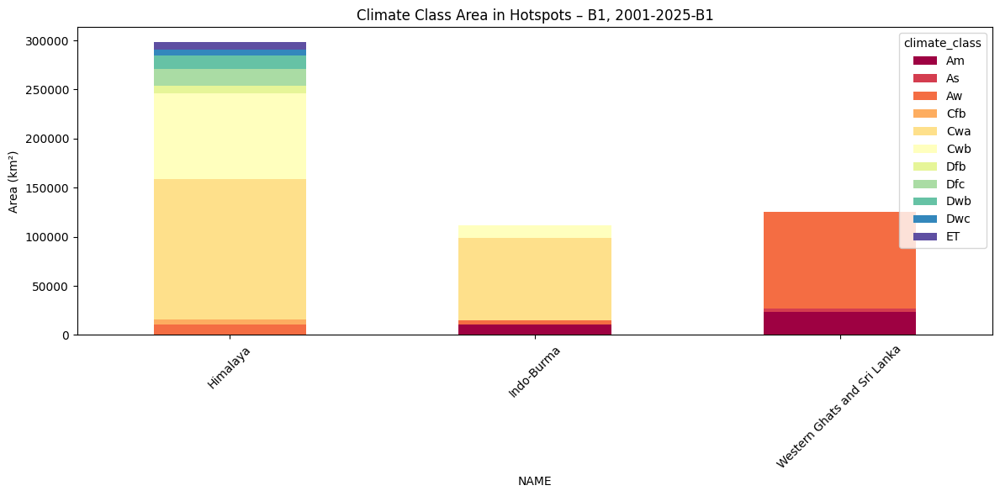

In [217]:
user_input_25()


In [221]:
# List of (period, scenario) pairs to analyze
target_periods_new = [
    ("1976-2000", "historical"),
    ("2001-2025-A1FI", "A1FI"),
    ("2001-2025-B1", "B1"),
    ("2076-2100-A1FI", "A1FI"),
    ("2076-2100-B1", "B1")
]

# Initialize dictionary to store dominant class per biodiversity hotspot and period-scenario
dominant_class = {}

# Loop through each (period, scenario) pair
for period, scenario in target_periods_new:
    # Filter data
    df_filtered =climate_hotspot_intersect_all [
        (climate_hotspot_intersect_all["period"] == period) &
        (climate_hotspot_intersect_all["scenario"] == scenario)
    ]
    
    # Group by biozone and climate class, sum area
    summary_new = (
        df_filtered.groupby(["NAME", "climate_class"])["area_km2"]
        .sum()
        .reset_index()
    )

    # For each biozone, find the class with max area
    max_per_zone = summary_new.loc[summary_new.groupby("NAME")["area_km2"].idxmax()]

    # Add to dictionary with period-scenario as column name
    col_name = f"{period}"
    dominant_class[col_name] = max_per_zone.set_index("NAME")["climate_class"]

# Combine all into a single DataFrame
dominant_df_new = pd.DataFrame(dominant_class)
dominant_df_new.reset_index(inplace=True)
dominant_df_new.columns.name = None  # remove index name for clean display

# Display the result
dominant_df_new


,NAME,1976-2000,2001-2025-A1FI,2001-2025-B1,2076-2100-A1FI,2076-2100-B1
0,Himalaya,Cwa,Cwa,Cwa,Cwa,Cwa
1,Indo-Burma,Cwa,Cwa,Cwa,Am,Cwa
2,Western Ghats and Sri Lanka,Am,Aw,Aw,Aw,Aw


In [225]:
def dominant_class_change_in_hotspots(
    dominant_df,
    period_ref="2001-2025-A1FI",
    period_future="2076-2100-A1FI",
    scenario="A1FI"
):
    """
    Calculate the change in area of the dominant climate class in each hotspot
    between reference and future periods under the same scenario.
    """
    
    # Extract dominant class in each hotspot from previous table
    ref_dominant = dominant_df[["NAME", period_ref]].rename(
        columns={period_ref: "dominant_class"}
    )

    # Filtering intersected data for reference and future periods
    df_ref = climate_hotspot_intersect_all[
        (climate_hotspot_intersect_all["period"] == period_ref) &
        (climate_hotspot_intersect_all["scenario"] == scenario)
    ]
    df_future = climate_hotspot_intersect_all[
        (climate_hotspot_intersect_all["period"] == period_future) &
        (climate_hotspot_intersect_all["scenario"] == scenario)
    ]

    # Area of dominant class in reference
    area_ref = (
        df_ref.groupby(["NAME", "climate_class"])["area_km2"]
        .sum()
        .reset_index()
        .rename(columns={"area_km2": "area_in_ref_period"})
    )

    # Area of same class in future
    area_future = (
        df_future.groupby(["NAME", "climate_class"])["area_km2"]
        .sum()
        .reset_index()
        .rename(columns={"area_km2": "area_in_future"})
    )

    #  Merging with dominant class info
    merged = pd.merge(ref_dominant, area_ref, left_on=["NAME", "dominant_class"], right_on=["NAME", "climate_class"], how="left")
    merged = pd.merge(merged, area_future, left_on=["NAME", "dominant_class"], right_on=["NAME", "climate_class"], how="left")

    # Clean and calculate net change
    merged["area_in_ref_period"] = merged["area_in_ref_period"].fillna(0)
    merged["area_in_future"] = merged["area_in_future"].fillna(0)
    merged["net_change"] = merged["area_in_future"] - merged["area_in_ref_period"]

    # Final columns
    result = merged[["NAME", "dominant_class", "area_in_ref_period", "area_in_future", "net_change"]].round(2)
    result.columns = ["Hotspot", "Dominant Class", "Area (2001–2025)", "Area (2076–2100)", "Net Change (km²)"]

    return result


In [227]:
hotspot_dominant_change_df = dominant_class_change_in_hotspots(dominant_df_new)
display(hotspot_dominant_change_df)


,Hotspot,Dominant Class,Area (2001–2025),Area (2076–2100),Net Change (km²)
0,Himalaya,Cwa,138707.21,112999.77,-25707.44
1,Indo-Burma,Cwa,80353.73,23047.02,-57306.71
2,Western Ghats and Sri Lanka,Aw,95828.77,93119.55,-2709.22


### Insights: Climate Shifts in India's Biodiversity Hotspots

This phase explores how climate zones evolve across three of India’s most ecologically significant regions — the **Himalaya**, **Indo-Burma**, and the **Western Ghats & Sri Lanka** — using the **Köppen–Geiger classification**. The goal is to understand spatial and temporal climate transformations under different emissions scenarios.

---

####  Climate Zone Trends: 1901–2100 (All Scenarios)

We began with **stacked area graphs** showing the distribution of climate zones over time (1901–2100) within each hotspot. The visualization tool supports dynamic selection of **periods** and **scenarios** (A1FI, B1, historical), making it suitable for comparative analysis.

Key trends:
- **Tropical savanna (Aw)** expands significantly in Western Ghats over time.
- **Humid subtropical (Cwa)** declines steadily in Indo-Burma and the Himalaya.
- The tool highlights **gradual biome transitions** and **scenario-based variability**, offering a panoramic view of long-term climate shifts.

---

#### Dominant Climate Class Analysis (2001–2100, A1FI)

To complement the full-range trends, we analyzed **dominant climate zones by area** for three key time slices under the A1FI scenario:
- Historical baseline (1976–2000)
- Near-future reference (2001–2025)
- Long-term projection (2076–2100)

We then quantified the **net area change (km²)** for each hotspot’s 2001–2025 dominant class by 2100, offering a targeted look at projected ecological stress points.

Findings:
- **Indo-Burma** may lose over 57,000 km² of its dominant Cwa zone, signaling major climate pressure.
- The **Himalaya** shows significant contraction of Cwa as well, likely impacting alpine ecosystems.
- **Western Ghats** remain more stable, but a measurable decline in Aw still appears.

---

#### Summary

This phase combines **broad temporal visualization** with **focused dominant class analysis**, enabling both high-level interpretation and hotspot-specific insights. The results reveal critical shifts in climatic regimes that can inform **climate-resilient conservation strategies** and contribute meaningfully to spatial planning under changing climate conditions.


#### **Transition Matrix :** 

In [230]:

# Step 1: Filter climate classification data for each period-scenario
df_2001 = climate_data_india_m[
    (climate_data_india_m["period"] == "2001-2025-A1FI") &
    (climate_data_india_m["scenario"] == "A1FI")
].copy()

df_2100 = climate_data_india_m[
    (climate_data_india_m["period"] == "2076-2100-A1FI") &
    (climate_data_india_m["scenario"] == "A1FI")
].copy()

# Step 2: Rename climate class columns for clarity
df_2001 = df_2001[["geometry", "climate_class"]].rename(columns={"climate_class": "class_2001"})
df_2100 = df_2100[["geometry", "climate_class"]].rename(columns={"climate_class": "class_2100"})

# Step 3: Perform spatial overlay to find intersections and matching pairs
overlay = gpd.overlay(df_2001, df_2100, how="intersection",keep_geom_type=False)



# Step 4: Calculate area of each overlapping zone in square kilometers
overlay["area_km2"] = overlay.geometry.area / 10**6

# Step 5: Generate the transition matrix
transition_matrix = (
    overlay.groupby(["class_2001", "class_2100"])["area_km2"]
    .sum()
    .unstack(fill_value=0)
    .round(2)
)

transition_matrix



class_2100,Am,As,Aw,BSh,BSk,BWh,Cfa,Cfb,Csb,Cwa,Cwb,Dfb,Dsb,Dsc,Dwb,Dwc,ET
class_2001,,,,,,,,,,,,,,,,,
Am,70777.58,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
As,0.00,160807.07,7018.19,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Aw,22724.15,135739.16,981737.89,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
BSh,0.00,65158.91,185410.68,313014.75,0.00,0.00,0.00,0.00,0.00,2095.32,0.00,0.00,0.00,0.00,0.00,0.00,0.00
BSk,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,60.66,0.00,0.00
BWh,0.00,0.00,0.00,63221.23,0.00,110168.71,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Cfa,0.00,0.00,0.00,0.00,0.00,0.00,199.41,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Cfb,0.00,0.00,0.00,0.00,0.00,0.00,5146.18,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Csa,0.00,117391.31,11225.41,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


### Transition Matrix Insights (2001–2025 → 2076–2100, A1FI Scenario)

This matrix reveals how climate zones transition from early 21st century (2001–2025) to the late 21st century (2076–2100) under a high-emission scenario (A1FI). The rows represent the original (2001) climate class, while columns show what they transitioned into by 2100.

---

####  High Stability Zones

- **Am (Tropical Monsoon):**  
  Retained nearly **100% of its area** (~70,778 km²), showing strong resilience. Likely concentrated in **Western Ghats, Northeast India, and the Andaman Islands**.

- **Cwa (Humid Subtropical, Dry Winter):**  
  Shows both **stability** and **inflow** from other classes like Aw and As, indicating shifting precipitation regimes in regions like the **Gangetic Plains**.

---

#### Major Climatic Transitions

- **Aw (Tropical Savanna):**  
  Expanded significantly (~981,738 km² retained), gaining land from **As and BSh**, and even some from **Cwa**. Indicates a **widening of savanna conditions**, consistent with **warming and altered monsoon**.

- **As → Aw Transition:**  
  Over **135,739 km²** of As transitioned to Aw — highlighting **seasonal drying trends** in formerly humid tropical zones.

- **BSh (Hot Semi-Arid):**  
  Gained large tracts from **Aw and As**, growing to over **313,015 km²** — a clear marker of **increasing aridity** in regions like **Deccan Plateau**.

---

####  Expansion of Dry and Desert Climates

- **BWh (Hot Desert):**  
  Gained area from BSh (~63,221 km²), representing **desertification trends** especially in **Western India (e.g., Thar Desert expansion)**.

- **Emergence of BSk, Dwc:**  
  Suggests **new dry/cold variants** forming in **upland regions**, especially under **altitudinal warming and snow loss**.

---

#### Highland and Subarctic Shifts

- **Cwb (Subtropical Highland):**  
  Retained ~44,234 km² and gained fragments from **Cwa and Dfb**, showing **mixing of temperate and subtropical zones** in the Himalayas.

- **Dfc → Dsc/Dwc/ET:**  
  Indicates **cold zone fragmentation**, likely due to **glacier retreat**, temperature rise, and changing snow patterns in **Trans-Himalayas**.

---

#### Summary

- **Tropical and semi-arid climates** are **expanding**.
- **Cold and temperate zones** are **shrinking or shifting upward in elevation**.
- **Dry climates** like BSh and BWh are **growing aggressively**, posing a threat to agriculture and water security.

This matrix not only confirms known climate patterns but also offers **geospatially grounded evidence** of how India’s climate zones may evolve — essential for **adaptation planning**.


#### SDG Linkages (Climate Classification Analysis):

- SDG 13 (Climate Action): Supports climate adaptation by identifying spatial and temporal shifts in climate zones.
- SDG 15 (Life on Land): Highlights risks to ecosystems and biodiversity from changing climate patterns.
- SDG 2 (Zero Hunger): Shows potential impact of climate shifts on agriculture and food security.
- SDG 6 (Clean Water): Tracks climate-driven changes in rainfall, affecting water availability.
-SDG 11 (Sustainable Cities): Informs urban planning in regions facing climatic transitions.



## Conclusion

This project provides a comprehensive spatial and temporal analysis of climate change impacts across India, with a particular focus on biogeographic zones and biodiversity hotspots from **1901 to 2100**.

By combining **Köppen-Geiger climate classification data**, **tree cover loss**, and **ecological regions**, we achieved the following:

### Key Findings:
- **Poleward and altitudinal shifts** in climate zones were observed, with **warmer/drier classes (e.g., Aw, As)** expanding into regions historically dominated by cooler or wetter climates like **Cwa, Cwb**.
- **Biodiversity hotspots** such as the **Indo-Burma region and Western Ghats** are showing **notable shifts** in dominant climate zones, which may impact their ecological integrity.
- **High-altitude zones** like the **Trans-Himalaya** experienced a **reduction in tundra and subarctic climates (ET, Dfc)**, indicating warming trends.
- **Heatmaps and transition matrices** clearly depicted how certain climate classes are replacing others over time, revealing **non-linear, region-specific transitions**.
- The **dominant climate class** in each zone was tracked from a baseline period (2001–2025) to future projection (2076–2100, A1FI), helping identify the **magnitude and direction of changes**.
- **Tree cover loss analysis** showed how land cover changes intersect with climate shifts, further stressing ecosystems.

### Techniques Used:
- Geospatial overlay using **GeoPandas** and **shapefiles** of India's zones and hotspots.
- Climate zone area summarization by **period**, **scenario**, and **zone**.
- **Interactive heatmaps**, **stacked bar graphs**, and **climate transition matrices**.
- Time-series **animation** of climate zone changes across periods for selected regions.


### Impact and Relevance:
This analysis bridges **climate data science and policy relevance**, offering:
- Spatial insights for **climate adaptation planning**.
- Evidence for **ecological risk assessment** in biodiversity-rich areas.
- A framework for extending this work into **sustainable development**, **climate policy**, or **conservation science** projects.

---

**Final Note**

This project offers a comprehensive geospatial analysis of climate classification changes across India using the Köppen–Geiger dataset (1901–2100). By integrating historical and scenario-based climate data with India’s biogeographic zones and biodiversity hotspots, the study highlights the spatial and temporal dynamics of climate zone transitions.

Through a combination of spatial overlays, climate zone dominance tracking, area change quantification, transition matrices, and visualizations (including heatmaps, stacked plots, and animated charts), the analysis provides a clear picture of how India’s climate zones are shifting — particularly under the high-emission A1FI scenario.

These findings support data-informed discussions on climate adaptation, ecological vulnerability, and regional planning. The workflow demonstrates practical application of Python-based geospatial tools, scenario comparison, and climate-cluster interpretation, with potential to inform future studies or environmental policy assessments.
